# Color-Based External Wound Image Segmentation Using Active Contour Technique

## Implementation of the Old Method: Active Contour
### Getting Data


In [2]:
import cv2               as cv
import matplotlib.pyplot as plt
import numpy             as np
import pandas            as pd
import os
import time

from skimage.filters import gaussian
from skimage.segmentation import active_contour

DATASET_PATH = 'datasets/Wound_dataset_1/' # Gets the path to the data from the directory

# This function is only valid for classified datasets followinf proper naming conventions
def pick(data, number):
    parent = data.capitalize()
    child = data.lower()
    # To fix the file naming for the given classes
    if parent == 'Ingrown_nails':
        child = 'ingrown_nail'
    if parent == 'Laceration':
        child = 'laseration'
    path = DATASET_PATH + parent + '/' + child + ' (' + str(number) + ').jpg'
    if not os.path.exists(path):
        print('File not found')
    return path

image = cv.imread(pick('cut', 5))

## Pre-processing

### Grayscaling

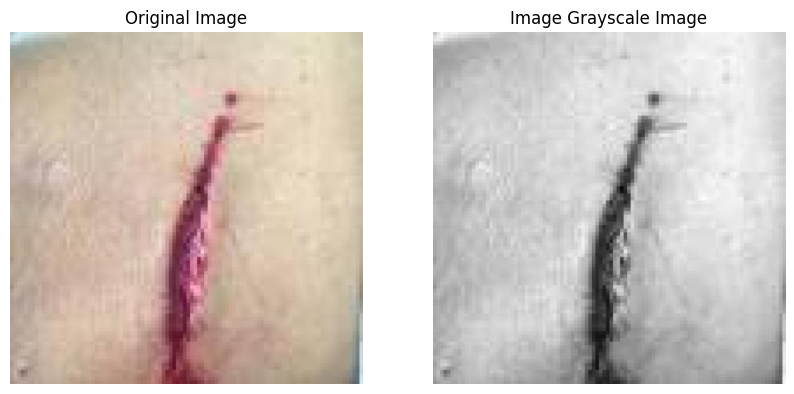

In [13]:
# image_grayscale = cv.cvtColor(image, cv.COLOR_BGR2GRAY)

# fig, axes = plt.subplots(1, 2,figsize=(10, 5))
# axes[0].imshow(cv.cvtColor(image, cv.COLOR_BGR2RGB))
# axes[0].set_title("Original Image")
# axes[0].axis('off')
# axes[1].imshow(image_grayscale, cmap='gray')
# axes[1].set_title("Image Grayscale Image")
# axes[1].axis('off')
# plt.show()

### Enlightenment

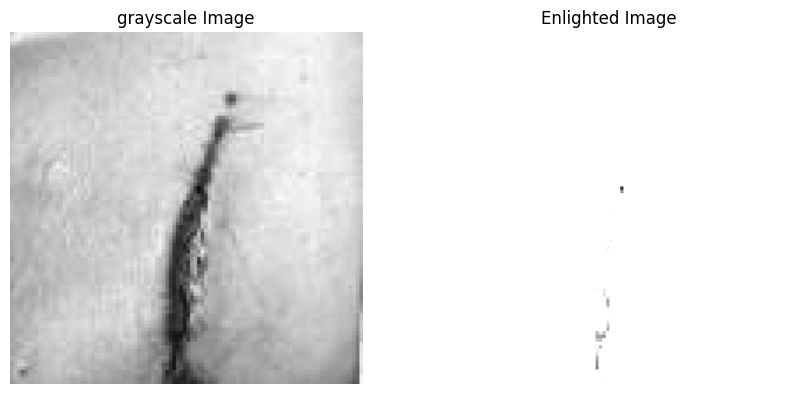

In [14]:
# brightness = 200
# image_brightened = cv.add(image_grayscale, brightness)

# fig, axes = plt.subplots(1, 2,figsize=(10, 5))
# axes[0].imshow(image_grayscale, cmap='gray')
# axes[0].set_title("grayscale Image")
# axes[0].axis('off')
# axes[1].imshow(image_brightened, cmap='gray')
# axes[1].set_title("Enlighted Image")
# axes[1].axis('off')
# plt.show()

### Denoising image

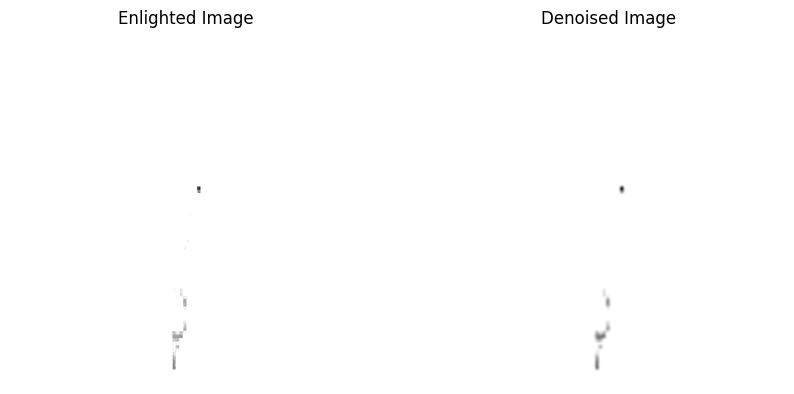

In [15]:
# image_denoise = cv.medianBlur(image_brightened, 3)
# image_denoise = cv.fastNlMeansDenoising(image_denoise, None, 10, 10, 7)

# fig, axes = plt.subplots(1, 2,figsize=(10, 5))
# axes[0].imshow(image_brightened, cmap='gray')
# axes[0].set_title("Enlighted Image")
# axes[0].axis('off')
# axes[1].imshow(image_denoise, cmap='gray')
# axes[1].set_title("Denoised Image")
# axes[1].axis('off')
# plt.show()

### Contrast Adjustment

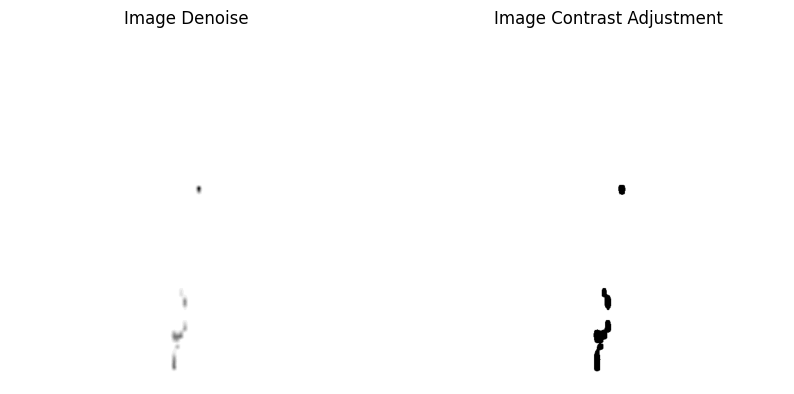

In [16]:
# image_contrast_adjusted = cv.equalizeHist(image_denoise)

# fig, axes = plt.subplots(1, 2,figsize=(10, 5))
# axes[0].imshow(image_denoise, cmap='gray')
# axes[0].set_title("Image Denoise")
# axes[0].axis('off')
# axes[1].imshow(image_contrast_adjusted, cmap='gray')
# axes[1].set_title("Image Contrast Adjustment")
# axes[1].axis('off')
# plt.show()

### Segmentation with Active Contour

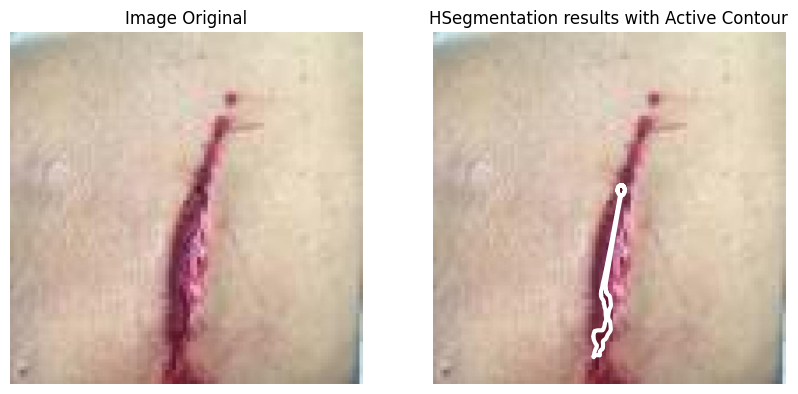

MSE : 110.95572021484375
PSNR: 13.839653320453715


In [17]:
s = np.linspace(0, 2*np.pi, 500)
r = 300 + 300*np.sin(s)
c = 320 + 300*np.cos(s)
init = np.array([r, c]).T

# Segmentation with Active Contour
snake = active_contour(gaussian(image_contrast_adjusted, 3, preserve_range=False),
                       init, alpha=0.01, beta=0, gamma=0.001)

fig, axes = plt.subplots(1, 2,figsize=(10, 5))
axes[0].set_title("Image Original")
axes[0].imshow(image[...,::-1], cmap='gray')
axes[0].axis('off')
axes[1].imshow(image[...,::-1], cmap='gray')
axes[1].plot(snake[:, 1], snake[:, 0], '-w', lw=3)
axes[1].set_title("HSegmentation results with Active Contour")
axes[1].axis('off')
plt.show()

difference = np.array(image_denoise) - np.array(image[:, :, 0])
mse = np.mean(np.square(difference))
psnr = 10 * np.log10(255 / np.sqrt(mse))
print("MSE :", mse)
print("PSNR:", psnr)

## Implementation of a New Method: Contour Detection

### Grayscaling

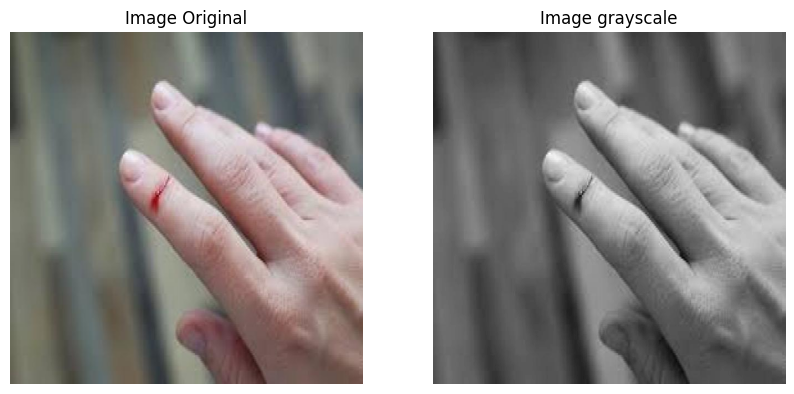

In [3]:
img = cv.imread(pick('cut', 11))
img_grayscale = cv.cvtColor(img, cv.COLOR_BGR2GRAY)

fig, axes = plt.subplots(1, 2,figsize=(10, 5))
axes[0].imshow(cv.cvtColor(img, cv.COLOR_BGR2RGB))
axes[0].set_title("Image Original")
axes[0].axis('off')
axes[1].imshow(img_grayscale, cmap='gray')
axes[1].set_title("Image grayscale")
axes[1].axis('off')
plt.show()

### Binary Thresholding

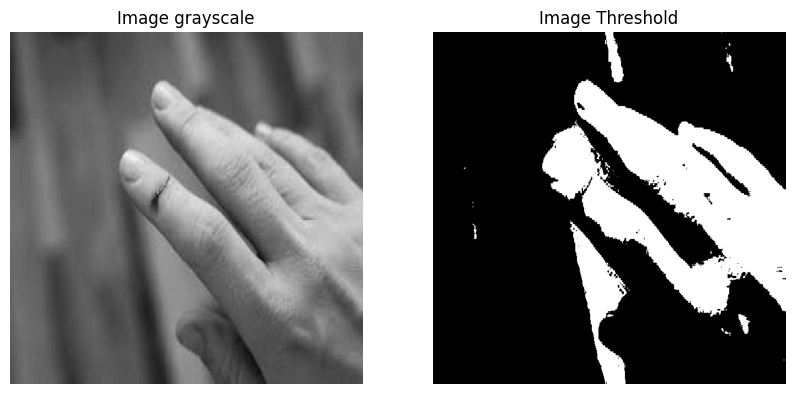

In [8]:
ret, thresh = cv.threshold(img_grayscale, 0, 255, cv.THRESH_BINARY + cv.THRESH_OTSU)

fig, axes = plt.subplots(1, 2,figsize=(10, 5))
axes[0].imshow(img_grayscale, cmap='gray')
axes[0].set_title("Image grayscale")
axes[0].axis('off')
axes[1].imshow(thresh, cmap='gray')
axes[1].set_title("Image Threshold")
axes[1].axis('off')
plt.show()

### Segmentation with Contour Detection

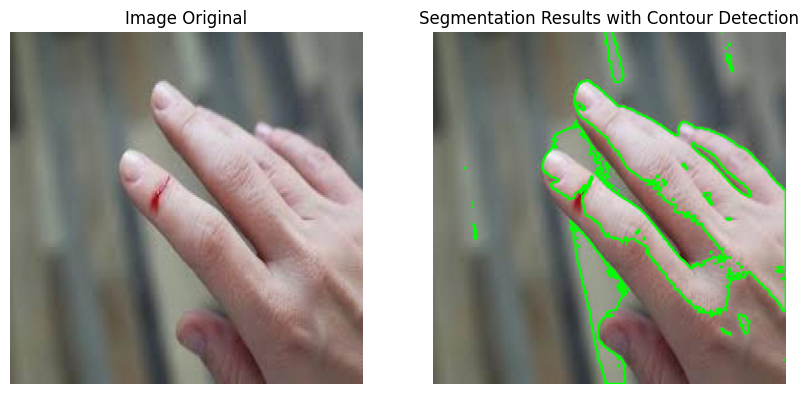

MSE : 6.282215169270834
PSNR: 20.074837768647722


In [9]:
contours, hierarchy = cv.findContours(image=thresh, mode=cv.RETR_TREE, method=cv.CHAIN_APPROX_NONE)
image_copy = img.copy()
cv.drawContours(image=image_copy, contours=contours, contourIdx=-1, color=(0, 255, 0), thickness=2, lineType=cv.LINE_AA)

fig, axes = plt.subplots(1, 2,figsize=(10, 5))
axes[0].imshow(img[...,::-1], cmap='gray')
axes[0].set_title("Image Original")
axes[0].axis('off')
axes[1].imshow(image_copy[...,::-1], cmap='gray')
axes[1].set_title("Segmentation Results with Contour Detection")
axes[1].axis('off')
plt.show()

difference = np.array(image_copy) - np.array(img)
mse = np.mean(np.square(difference))
psnr = 10 * np.log10(255 / np.sqrt(mse))
print("MSE :", mse)
print("PSNR:", psnr)

## Applying Active Contour to images contained in Datasets

### Active Contour function

In [11]:
def seg_active_contour(folder, number, bright, x, a, y, b):
    image = cv.imread(pick(folder, number))
    image_grayscale = cv.cvtColor(image, cv.COLOR_BGR2GRAY)
    brightness = bright
    image_brightened = cv.add(image_grayscale, brightness)
    image_denoise = cv.medianBlur(image_brightened, 3)
    image_denoise = cv.fastNlMeansDenoising(image_denoise, None, 10, 10, 7)
    image_contrast_adjusted = cv.equalizeHist(image_denoise)
    s = np.linspace(0, 2*np.pi, 500)
    r = x + a*np.sin(s)
    c = y + b*np.cos(s)
    init = np.array([r, c]).T
    snake = active_contour(gaussian(image_contrast_adjusted, 3, preserve_range=False),
                           init, alpha=0.01, beta=0, gamma=0.001)
    
    fig, axes = plt.subplots(1, 2, figsize=(10, 5))
    axes[0].set_title("Image Original")
    axes[0].imshow(image[..., ::-1], cmap='gray')
    axes[0].axis('off')
    axes[1].imshow(image[..., ::-1], cmap='gray')
    axes[1].plot(snake[:, 1], snake[:, 0], '-w', lw=3)
    axes[1].set_title("Segmentation Results with Active Contour")
    axes[1].axis('off')
    plt.show()
    difference = np.array(image_denoise) - np.array(image[:, :, 0])
    mse = np.mean(np.square(difference))
    psnr = 10 * np.log10(255 / np.sqrt(mse))
    print("MSE: ", mse)
    print("PSNR: ", psnr)

#### 1. image abrasion(3).jpg

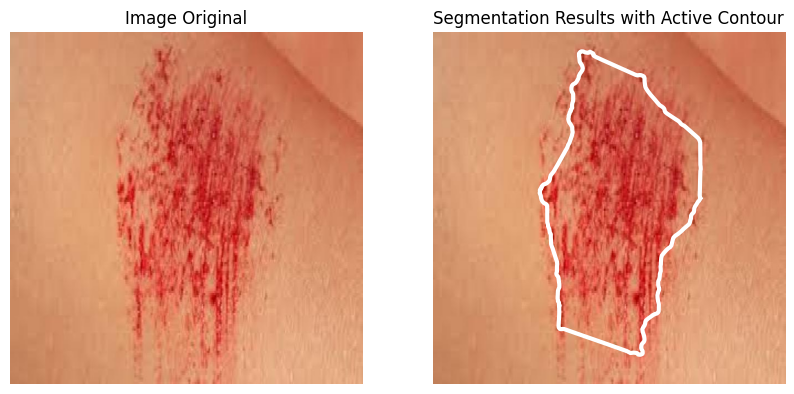

MSE:  104.5105419921875
PSNR:  13.969601304347288


In [12]:
seg_active_contour(folder='abrasions', number=3, bright=144, x=300, a=300, y=320, b=300)

#### 2. image bruises(2).jpg

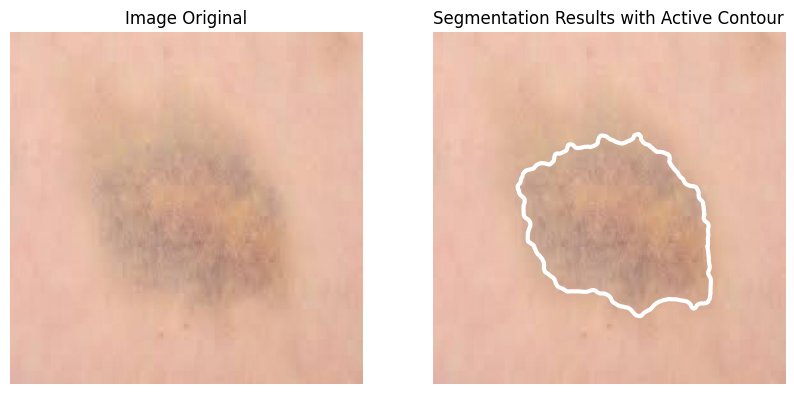

MSE:  120.726689453125
PSNR:  13.656385346111168


In [23]:
seg_active_contour(folder='bruises', number=2, bright=75, x=300, a=300, y=320, b=300)

#### 3. image burns(36).jpg

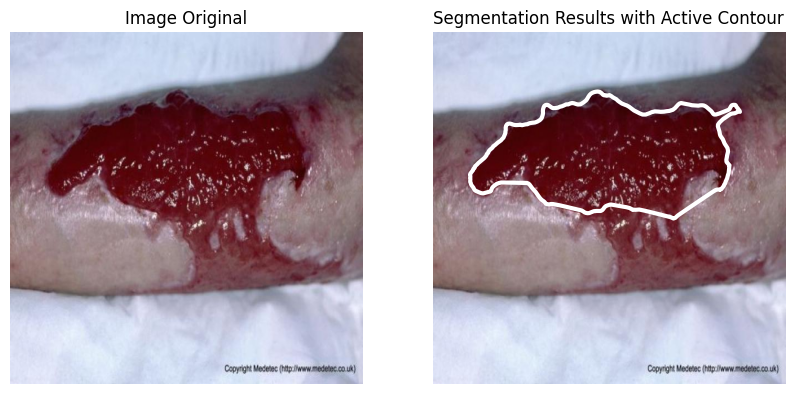

MSE:  106.11888671875
PSNR:  13.93643837834029


In [24]:
seg_active_contour(folder='burns', number=36, bright=215, x=300, a=300, y=320, b=300)

#### 4. image cut(15).jpg

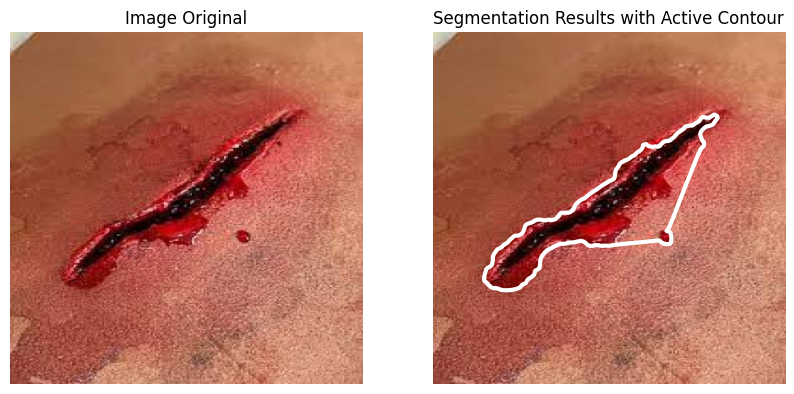

MSE:  107.27428466796874
PSNR:  13.912923668194342


In [25]:
seg_active_contour(folder='cut', number=15, bright=200, x=300, a=300, y=320, b=300)

#### 5. image laceration(15).jpg

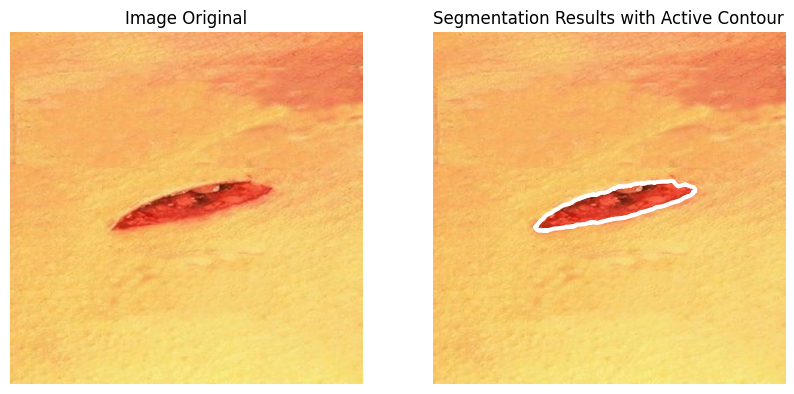

MSE:  106.0224560546875
PSNR:  13.93841250123522


In [26]:
seg_active_contour(folder='laceration', number=15, bright=120, x=300, a=300, y=320, b=300)

#### 6. image ingrown_nail(4).jpg

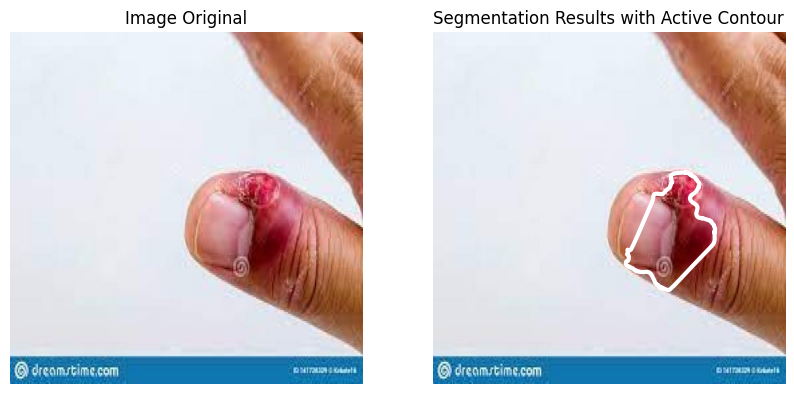

MSE:  98.7982080078125
PSNR:  14.091656466997389


In [27]:
seg_active_contour(folder='ingrown_nails', number=4, bright=146, x=320, a=150, y=360, b=150)

#### 7. image stab_wound(5).jpg

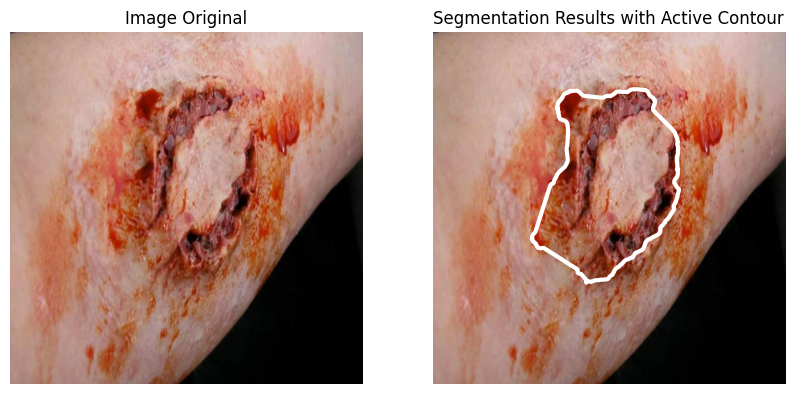

MSE:  108.4582080078125
PSNR:  13.889089681527595


In [28]:
seg_active_contour(folder='stab_wound', number=5, bright=180, x=250, a=200, y=250, b=200)

#### 8. image abrasions(1).jpg

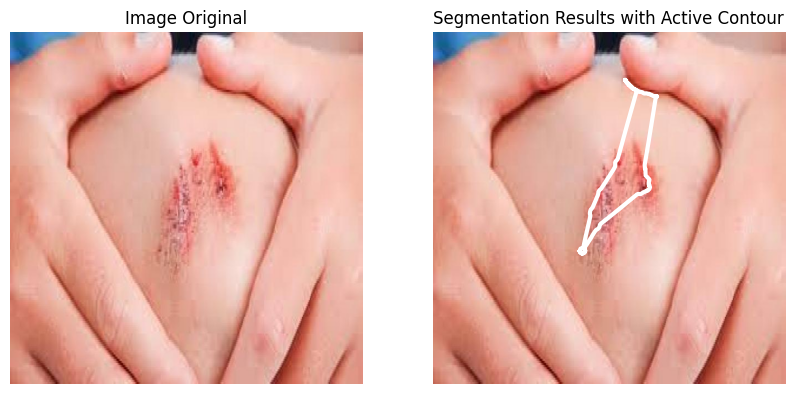

MSE:  106.8549560546875
PSNR:  13.921428454137335


In [13]:
seg_active_contour(folder='abrasions', number=2, bright=140, x=300, a=200, y=320, b=130)

#### 9. image bruises(1).jpg

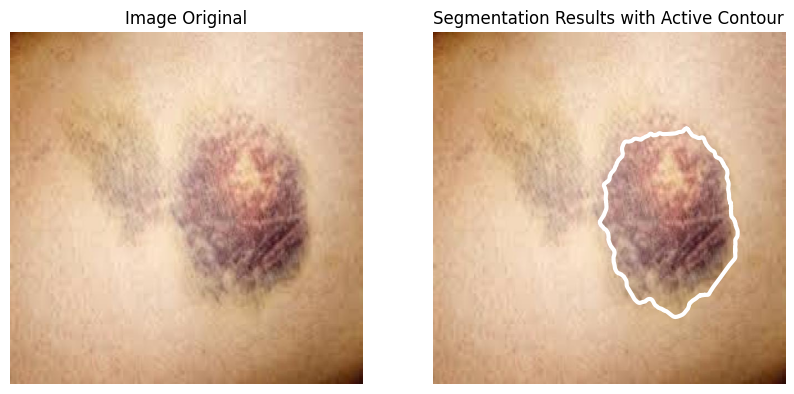

MSE:  88.656787109375
PSNR:  14.32684186148961


In [30]:
seg_active_contour(folder='bruises', number=1, bright=80, x=300, a=200, y=430, b=130)

#### 10. image burns(24).jpg

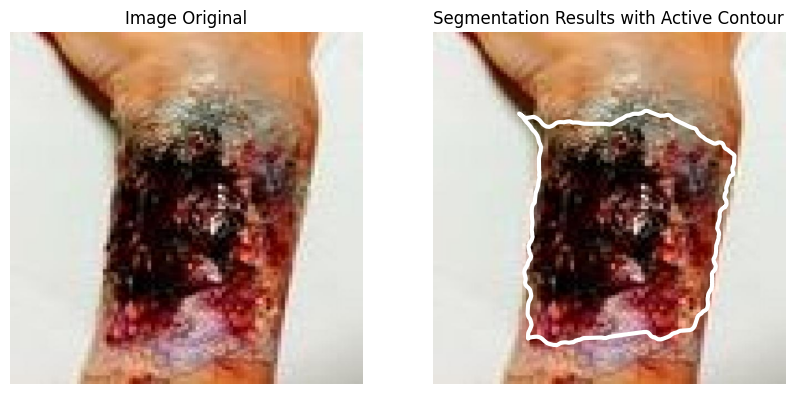

MSE:  111.52376708984374
PSNR:  13.828564650556407


In [31]:
seg_active_contour(folder='burns', number=24, bright=160, x=350, a=220, y=300, b=300)

#### 11. image abrasions(19).jpg

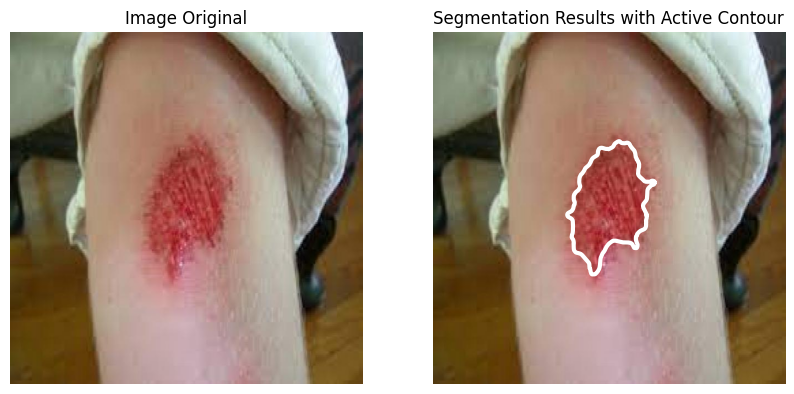

MSE:  105.6722607421875
PSNR:  13.945596810453688


In [32]:
seg_active_contour(folder='abrasions', number=19, bright=150, x=400, a=200, y=320, b=130)

#### 12. image bruises(9).jpg

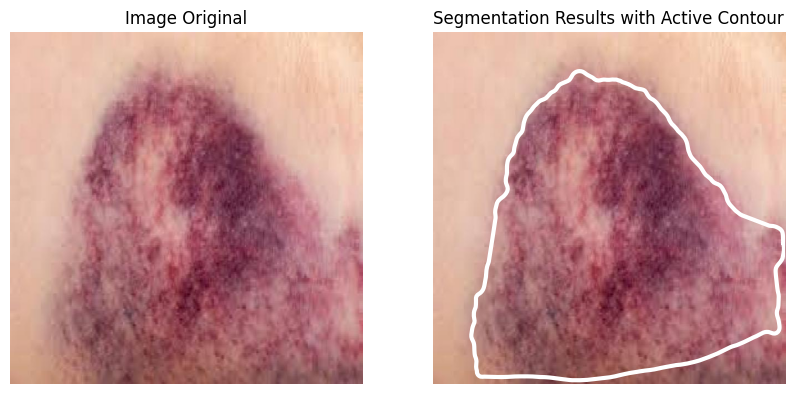

MSE:  112.93029052734374
PSNR:  13.801349577244293


In [33]:
seg_active_contour(folder='bruises', number=9, bright=100, x=350, a=450, y=320, b=450)

#### 13. image burns(22).jpg

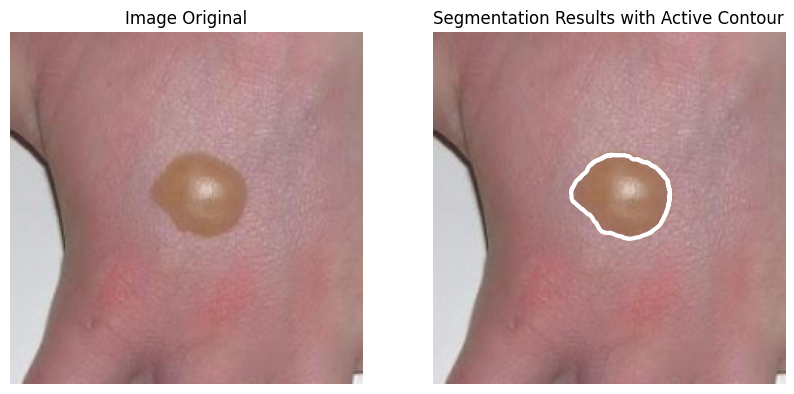

MSE:  65.01243408203125
PSNR:  15.000419672142055


In [34]:
seg_active_contour(folder='burns', number=22, bright=120, x=280, a=100, y=350, b=100)

#### 14. image cut(1).jpg

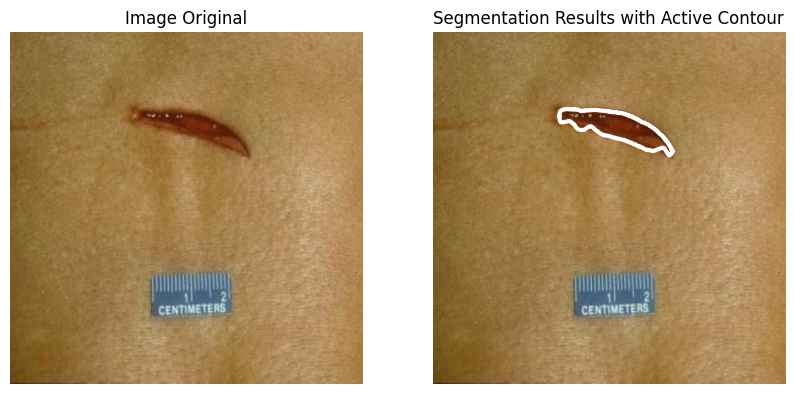

MSE:  114.54625732421874
PSNR:  13.770497286079276


In [35]:
seg_active_contour(folder='cut', number=1, bright=180, x=300, a=300, y=320, b=300)

#### 15. image laceration(2).jpg

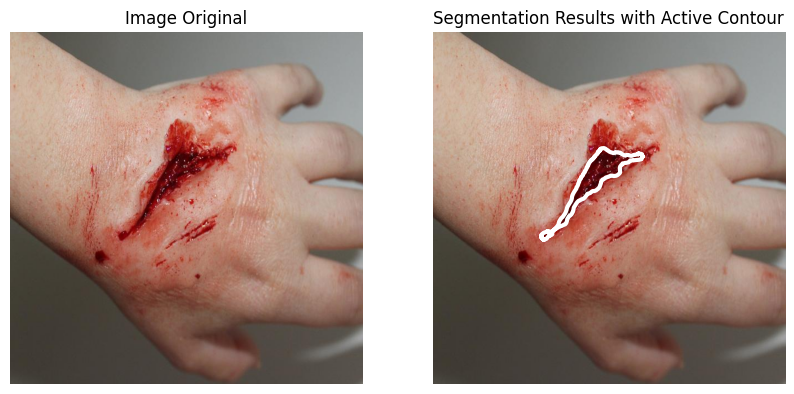

MSE:  107.74169921875
PSNR:  13.903482701236438


In [36]:
seg_active_contour(folder='laceration', number=2, bright=215, x=300, a=150, y=320, b=150)

#### 16. image ingrown_nail(26).jpg

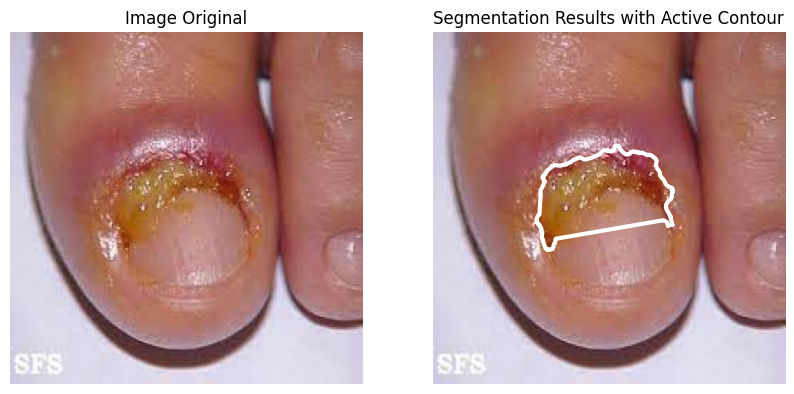

MSE:  109.40889404296875
PSNR:  13.870138664335183


In [37]:
seg_active_contour(folder='ingrown_nails', number=26, bright=160, x=340, a=150, y=300, b=150)

#### 17. image stab_wound(8).jpg

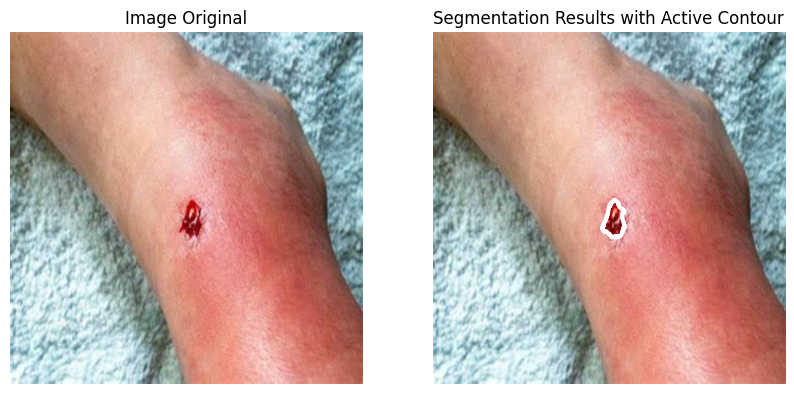

MSE:  101.97803466796876
PSNR:  14.02286861463692


In [38]:
seg_active_contour(folder='stab_wound', number=8, bright=180, x=300, a=200, y=300, b=200)

#### 18. image cut(2).jpg

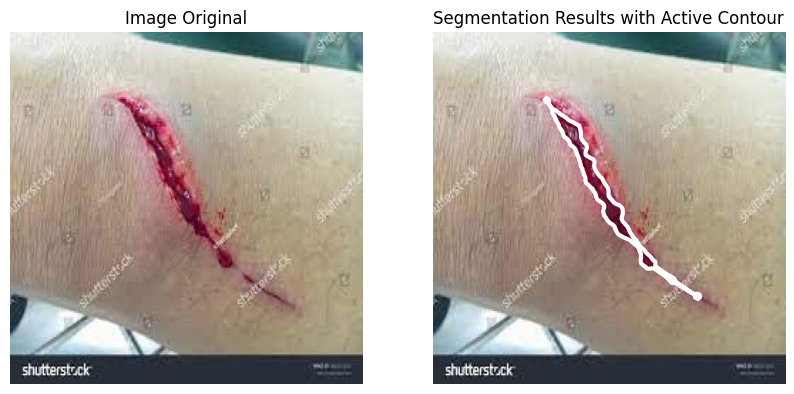

MSE:  98.36519775390624
PSNR:  14.10119445735112


In [39]:
seg_active_contour(folder='cut', number=2, bright=200, x=300, a=250, y=320, b=250)

#### 19. image laceration(10).jpg

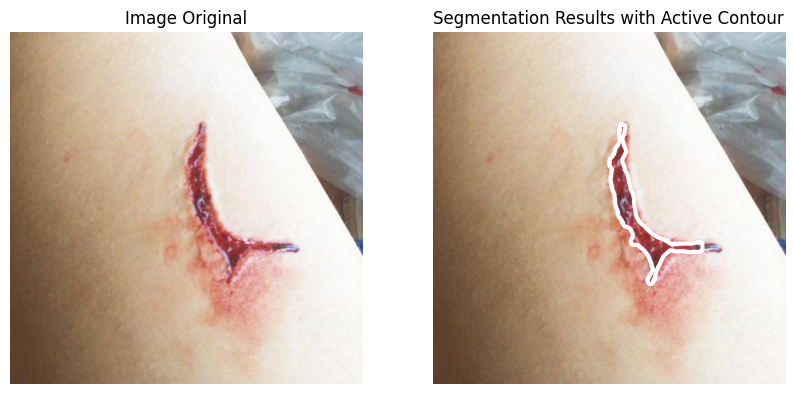

MSE:  107.469384765625
PSNR:  13.908977991035744


In [40]:
seg_active_contour(folder='laceration', number=10, bright=140, x=300, a=200, y=400, b=100)

#### 20. image ingrown_nail(28).jpg

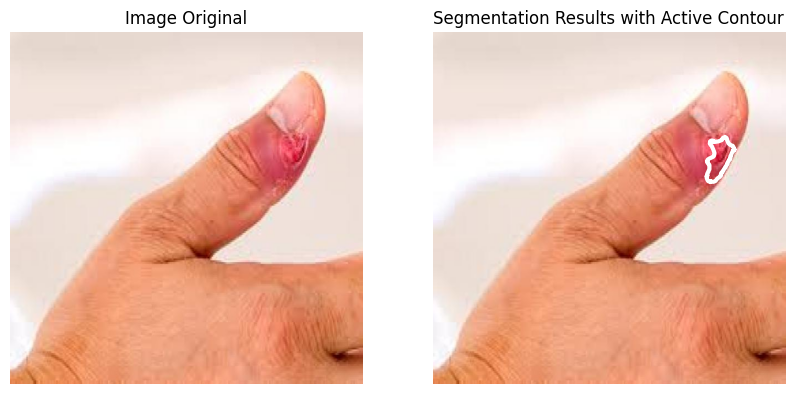

MSE:  99.19609375
PSNR:  14.08292895245082


In [41]:
seg_active_contour(folder='ingrown_nails', number=28, bright=157, x=150, a=150, y=430, b=150)

#### 21. image abrasions(17).jpg

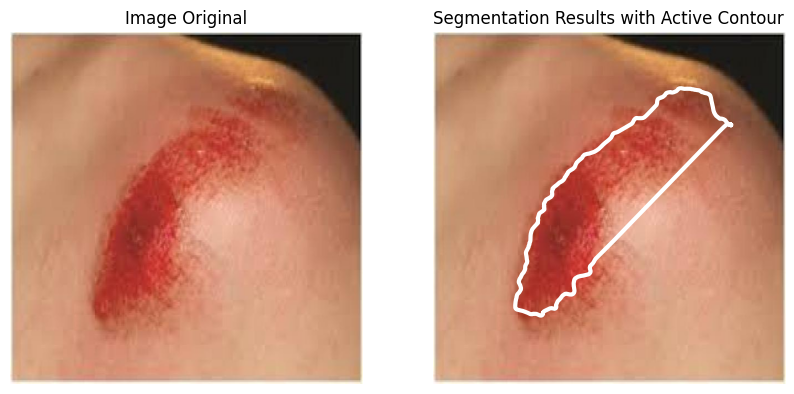

MSE:  96.09636474609376
PSNR:  14.151867009627068


In [42]:
seg_active_contour(folder='abrasions', number=17, bright=155, x=300, a=250, y=320, b=240)

#### 22. image bruises(18).jpg

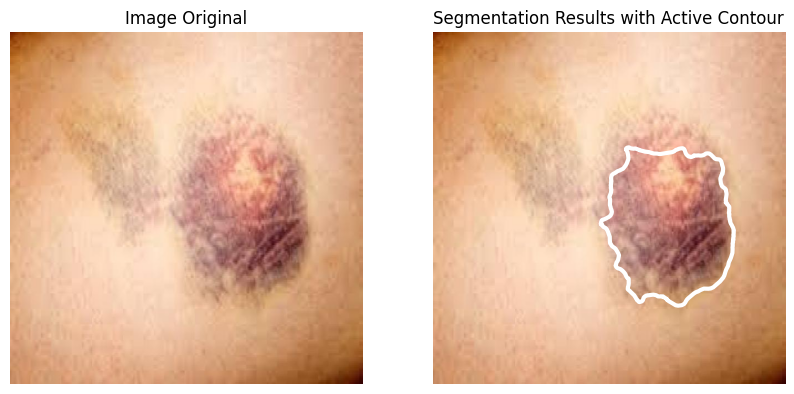

MSE:  100.79621826171875
PSNR:  14.04818061298236


In [43]:
seg_active_contour(folder='bruises', number=18, bright=90, x=300, a=200, y=350, b=200)

#### 23. image burns(22).jpg

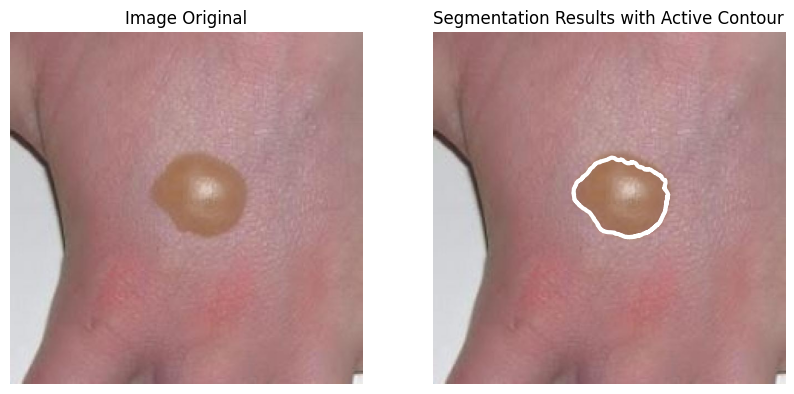

MSE:  80.837060546875
PSNR:  14.527349239269792


In [44]:
seg_active_contour(folder='burns', number=22, bright=125, x=300, a=150, y=380, b=150)

#### 24. image cut(20).jpg 

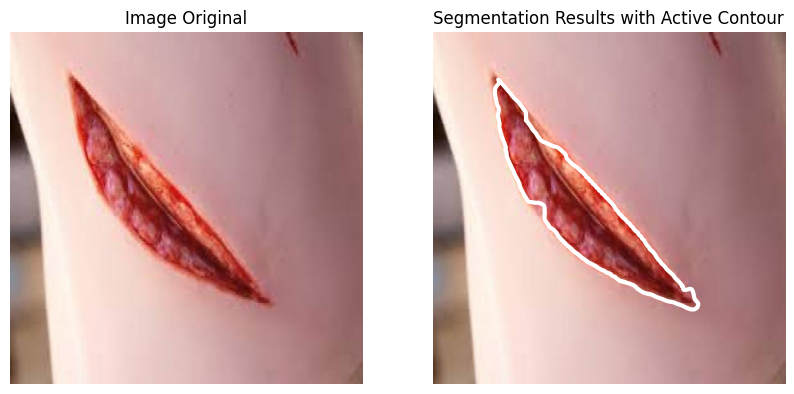

MSE:  102.31765869140625
PSNR:  14.015648835661134


In [45]:
seg_active_contour(folder='cut', number=20, bright=126, x=300, a=400, y=290, b=200)

#### 25. image laceration(14).jpg

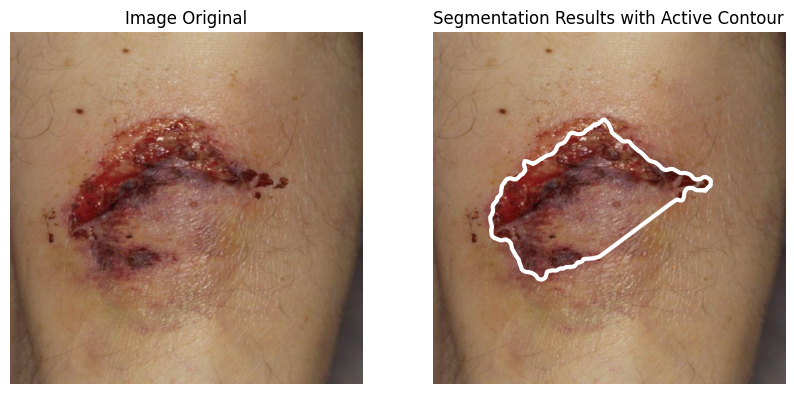

MSE:  109.36552490234375
PSNR:  13.870999595827806


In [46]:
seg_active_contour(folder='laceration', number=14, bright=180, x=300, a=200, y=300, b=200)

#### 26. image ingrown_nail(16).jpg

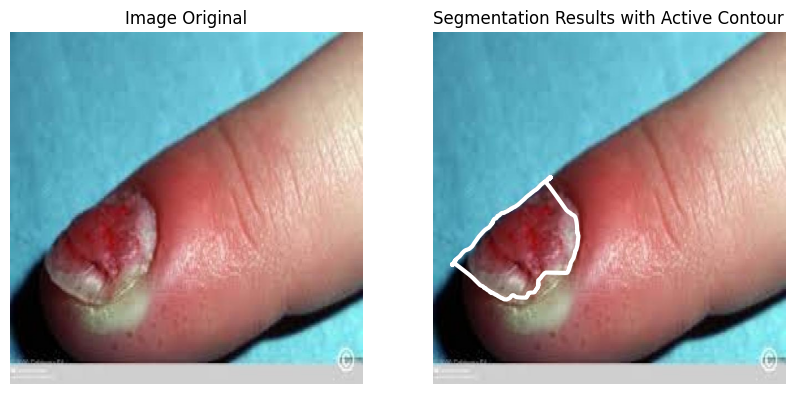

MSE:  105.540400390625
PSNR:  13.948308117162206


In [47]:
seg_active_contour(folder='ingrown_nails', number=16, bright=144, x=360, a=120, y=140, b=120)

#### 27. image stab_wound(20).jpg

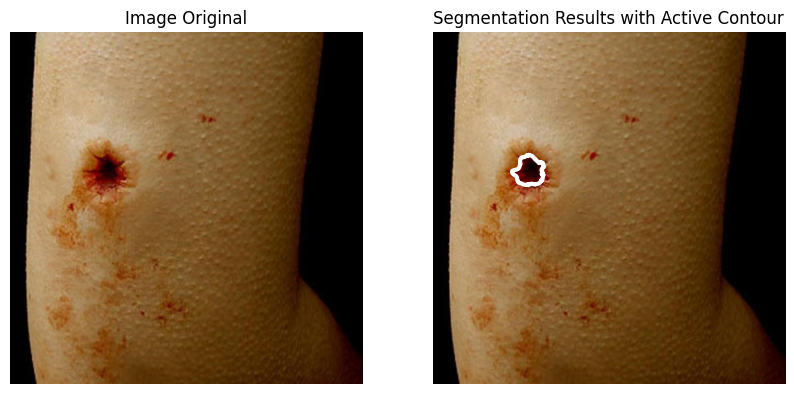

MSE:  106.71110107421875
PSNR:  13.924353798852714


In [48]:
seg_active_contour(folder='stab_wound', number=20, bright=215, x=300, a=200, y=250, b=200)

#### 28. image stab_wound(23).jpg

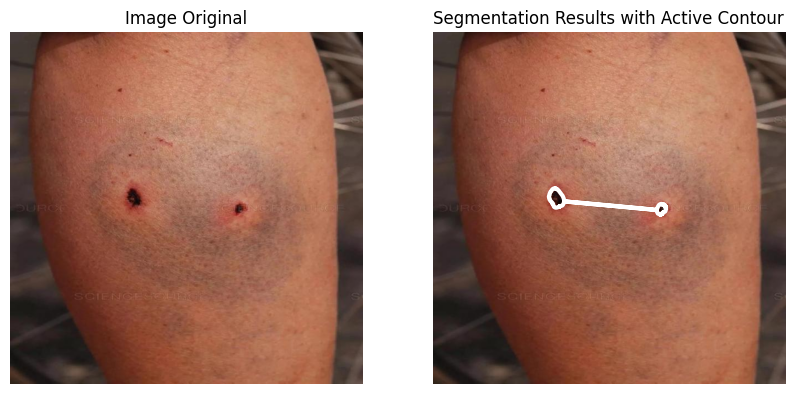

MSE:  109.95416015625
PSNR:  13.859343475840792


In [49]:
seg_active_contour(folder='stab_wound', number=23, bright=190, x=300, a=200, y=350, b=200)

#### 29. image cut(26).jpg

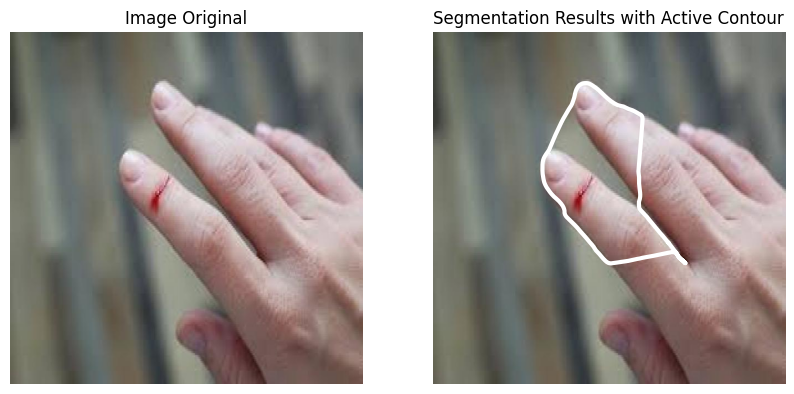

MSE:  104.34732177734375
PSNR:  13.972995270549609


In [50]:
seg_active_contour(folder='cut', number=11, bright=100, x=300, a=200, y=300, b=200)

#### 30. image laceration(20).jpg

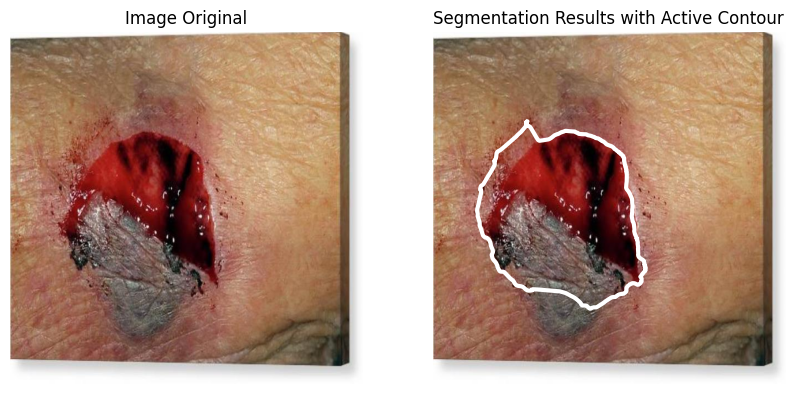

MSE:  106.39479736328126
PSNR:  13.930799845543508


In [51]:
seg_active_contour(folder='laceration', number=20, bright=185, x=300, a=200, y=280, b=200)

### Contour Detection Method Function

In [52]:
def seg_contour_detection(folder, number, threshold):
    img = cv.imread(pick(folder, number))
    img_grayscale = cv.cvtColor(img, cv.COLOR_BGR2GRAY)
    ret, thresh = cv.threshold(img_grayscale, threshold, 255, cv.THRESH_BINARY)
    contours, hierarchy = cv.findContours(image=thresh, mode=cv.RETR_TREE, method=cv.CHAIN_APPROX_NONE)
    image_copy = img.copy()
    cv.drawContours(image=image_copy, contours=contours, contourIdx=-1, color=(0, 255, 0), thickness=2, lineType=cv.LINE_AA)
    fig, axes = plt.subplots(1, 2, figsize=(10, 5))
    axes[0].imshow(img[..., ::-1], cmap='gray')
    axes[0].set_title("Image Original")
    axes[0].axis('off')
    axes[1].imshow(image_copy[..., ::-1], cmap='gray')
    axes[1].set_title("Segmentation Results with Contour Detection")
    axes[1].axis('off')
    plt.show()
    difference = np.array(image_copy) - np.array(img)
    mse = np.mean(np.square(difference))
    psnr = 10 * np.log10(255 / np.sqrt(mse))
    print("MSE: ", mse)
    print("PSNR: ", psnr)

#### 1. image abrasion(3).jpg

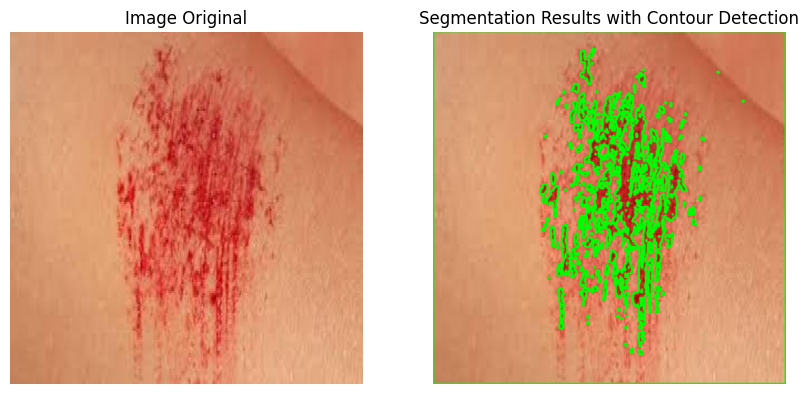

MSE:  16.330721842447918
PSNR:  18.000374896190987


In [53]:
seg_contour_detection(folder='abrasions', number=3, threshold=110)

#### 2. image bruises(2).jpg

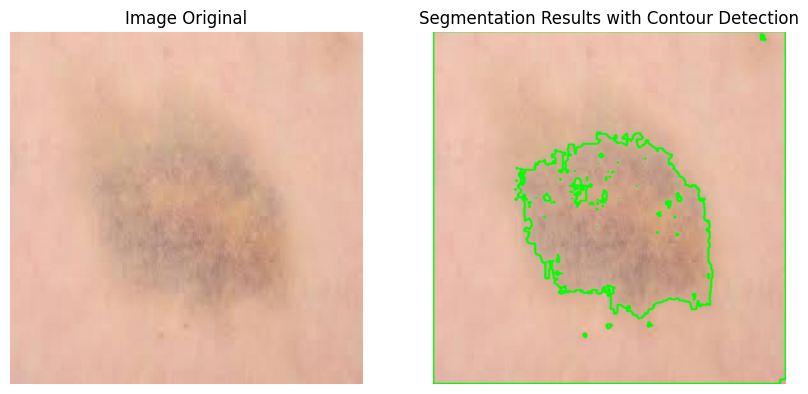

MSE:  6.257376302083333
PSNR:  20.083440438909975


In [54]:
seg_contour_detection(folder='bruises', number=2, threshold=180)

#### 3. image burns(36).jpg

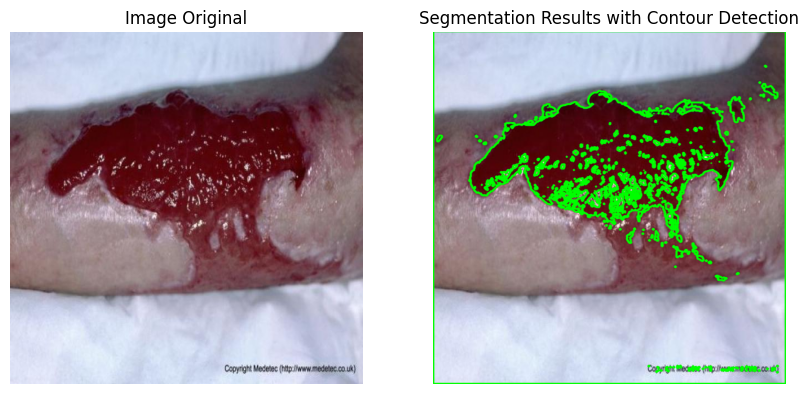

MSE:  11.744868977864583
PSNR:  18.716160922912685


In [55]:
seg_contour_detection(folder='burns', number=36, threshold=50)

#### 4. image cut(15).jpg

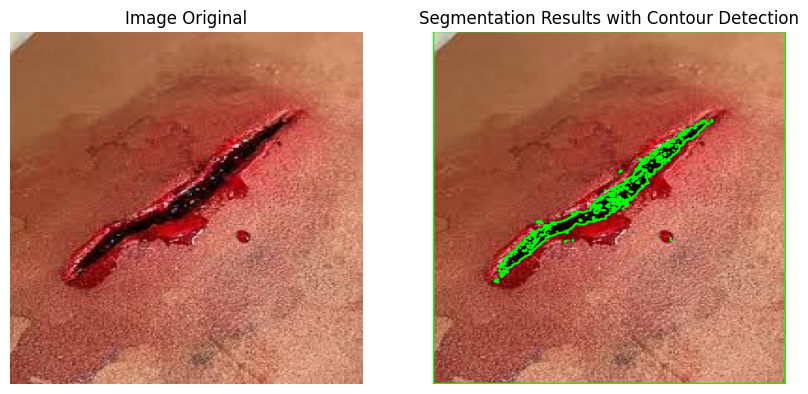

MSE:  4.511886393229167
PSNR:  20.79361102523311


In [56]:
seg_contour_detection(folder='cut', number=15, threshold=25)

#### 5. image laceration(15).jpg

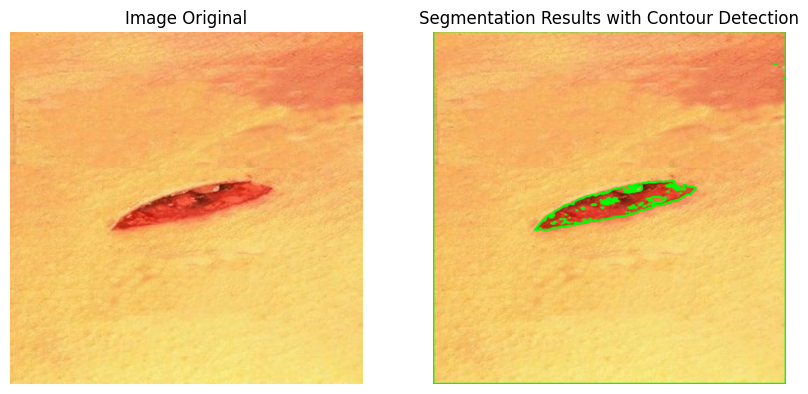

MSE:  3.4274853515625
PSNR:  21.390523767482815


In [57]:
seg_contour_detection(folder='laceration', number=15, threshold=130)

#### 6. image ingrown_nail(4).jpg

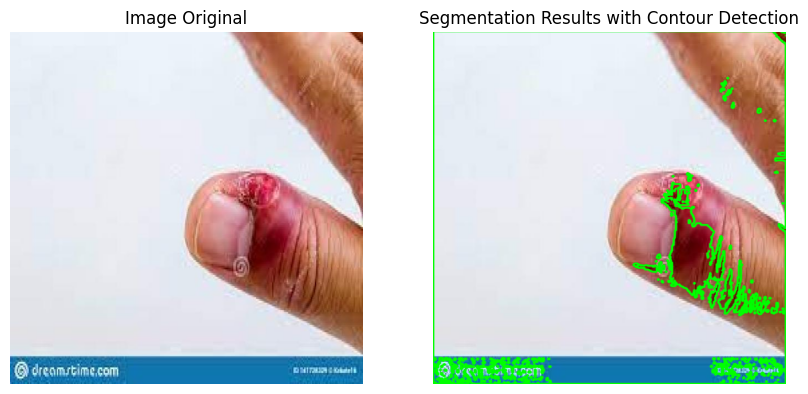

MSE:  8.271502278645833
PSNR:  19.477479835733433


In [58]:
seg_contour_detection(folder='ingrown_nails', number=4, threshold=82)

#### 7. image stab_wound(5).jpg

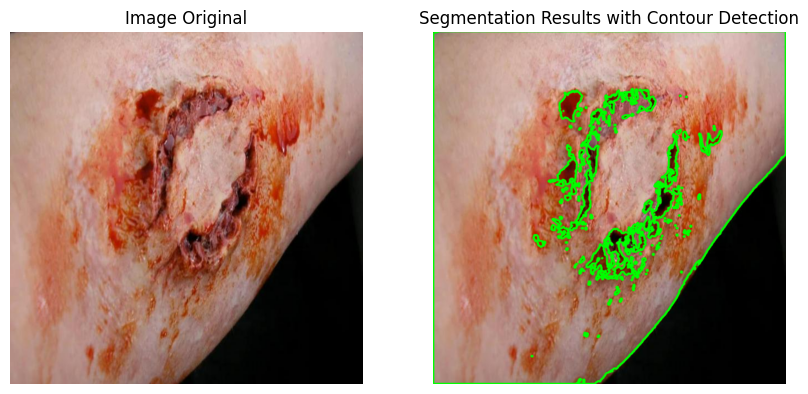

MSE:  8.757164713541666
PSNR:  19.353584212184924


In [59]:
seg_contour_detection(folder='stab_wound', number=5, threshold=70)

#### 8. image abrasions(1).jpg

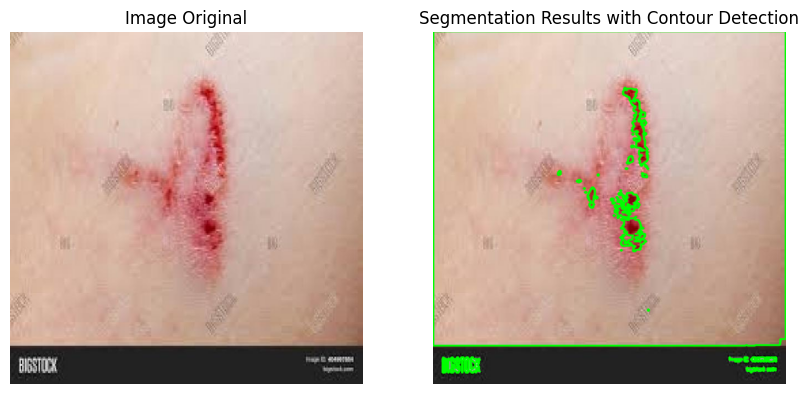

MSE:  5.284108072916666
PSNR:  20.45054334725828


In [60]:
seg_contour_detection(folder='abrasions', number=1, threshold=110)

#### 9. image bruises(1).jpg

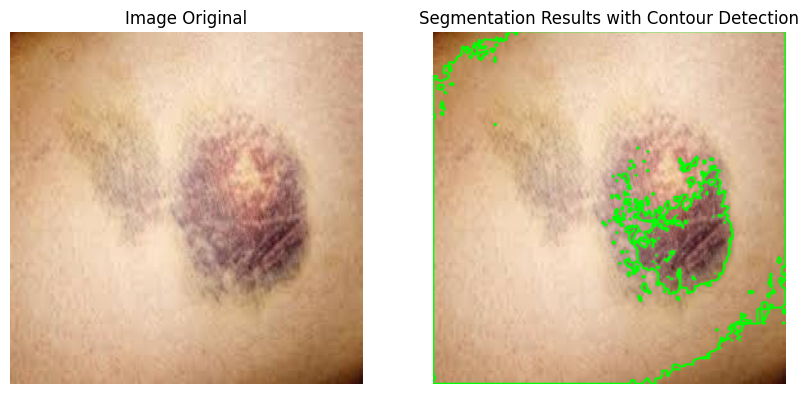

MSE:  6.940927734375
PSNR:  19.858314190543823


In [61]:
seg_contour_detection(folder='bruises', number=1, threshold=140)

#### 10. image burns(24).jpg

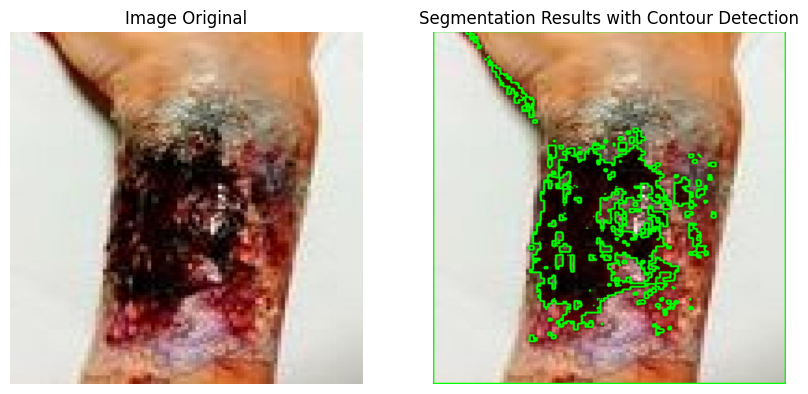

MSE:  10.64259765625
PSNR:  18.930163584617567


In [62]:
seg_contour_detection(folder='burns', number=24, threshold=35)

#### 11. image abrasions(19).jpg

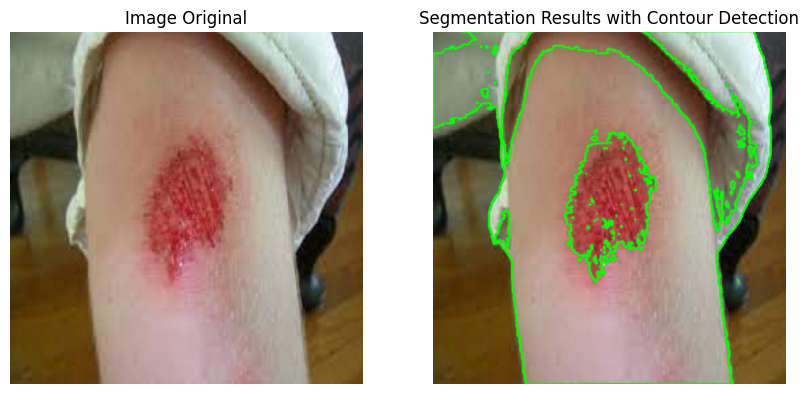

MSE:  7.775297037760416
PSNR:  19.611816858034167


In [63]:
seg_contour_detection(folder='abrasions', number=19, threshold=124)

#### 12. image bruises(9).jpg

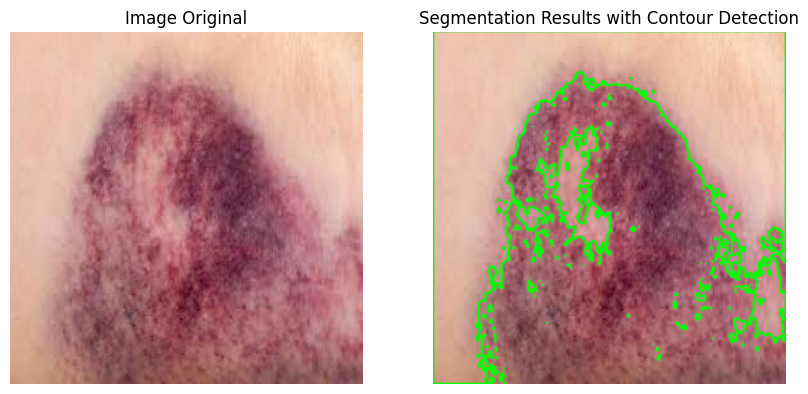

MSE:  7.937057291666667
PSNR:  19.5671042285233


In [64]:
seg_contour_detection(folder='bruises', number=9, threshold=144)

#### 13. image burns(22).jpg

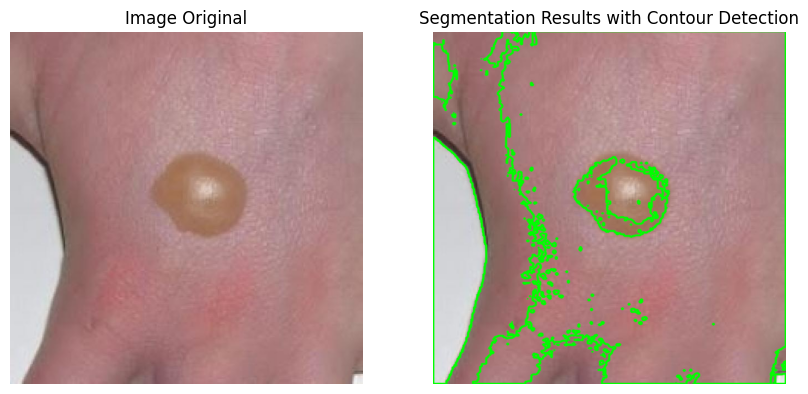

MSE:  9.284087727864584
PSNR:  19.226705626491086


In [65]:
seg_contour_detection(folder='burns', number=22, threshold=128)

#### 14. image cut(1).jpg

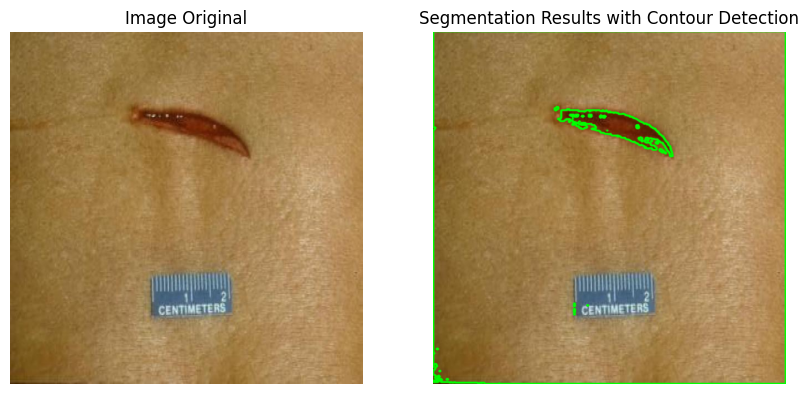

MSE:  3.18395751953125
PSNR:  21.550565480676344


In [66]:
seg_contour_detection(folder='cut', number=1, threshold=76)

#### 15. image laceration(2).jpg

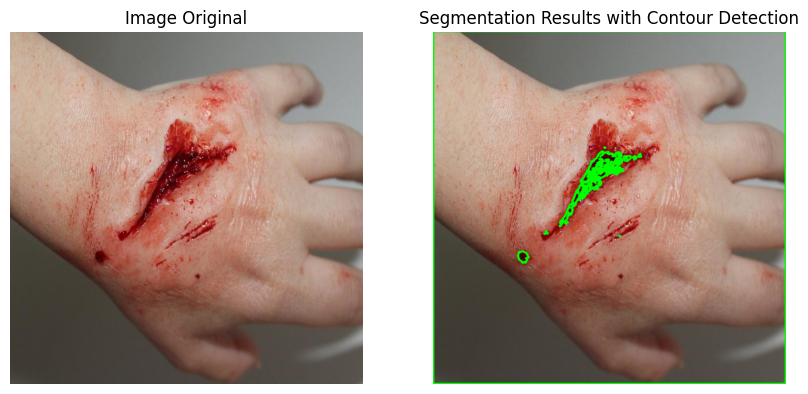

MSE:  3.2078898111979166
PSNR:  21.534304593577218


In [67]:
seg_contour_detection(folder='laceration', number=2, threshold=31)

#### 16. image ingrown_nail(26).jpg

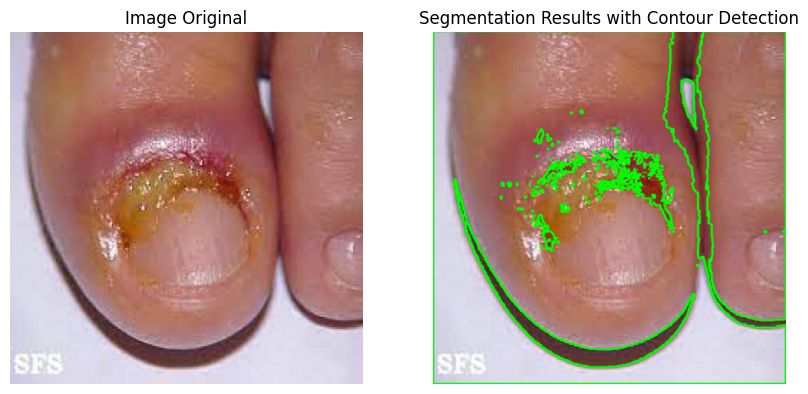

MSE:  9.83840087890625
PSNR:  19.1007792318498


In [68]:
seg_contour_detection(folder='ingrown_nails', number=26, threshold=93)

#### 17. image stab_wound(8).jpg

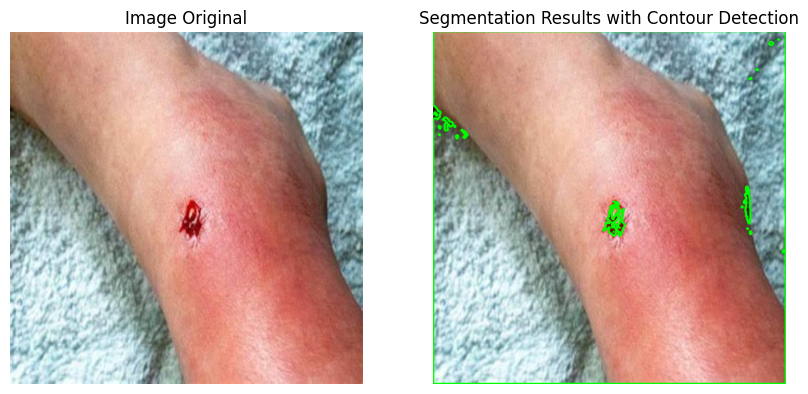

MSE:  3.0479964192708335
PSNR:  21.6453295420054


In [69]:
seg_contour_detection(folder='stab_wound', number=8, threshold=55)

#### 18. image cut(2).jpg

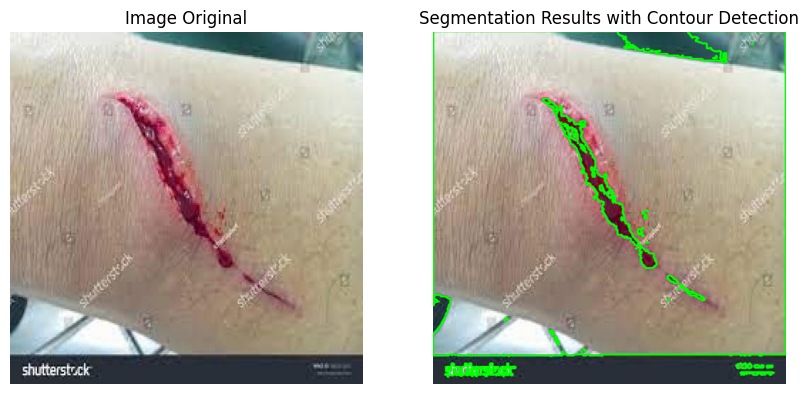

MSE:  6.164588216145833
PSNR:  20.115881445445943


In [70]:
seg_contour_detection(folder='cut', number=2, threshold=75)

#### 19. image laceration(10).jpg

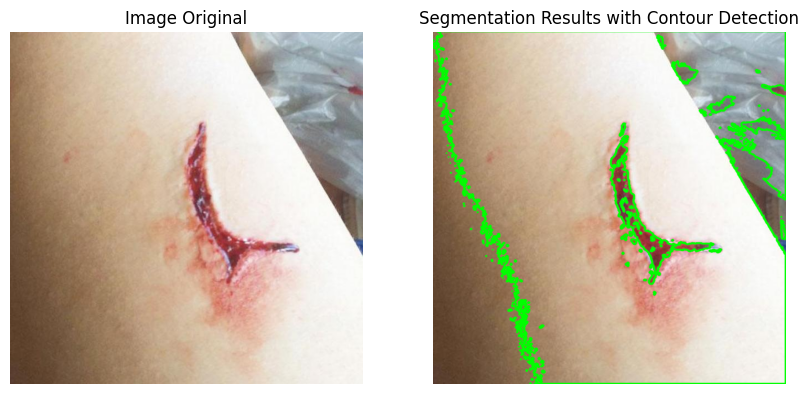

MSE:  7.521534016927084
PSNR:  19.68386968439685


In [71]:
seg_contour_detection(folder='laceration', number=10, threshold=125)

#### 20. image ingrown_nail(28).jpg

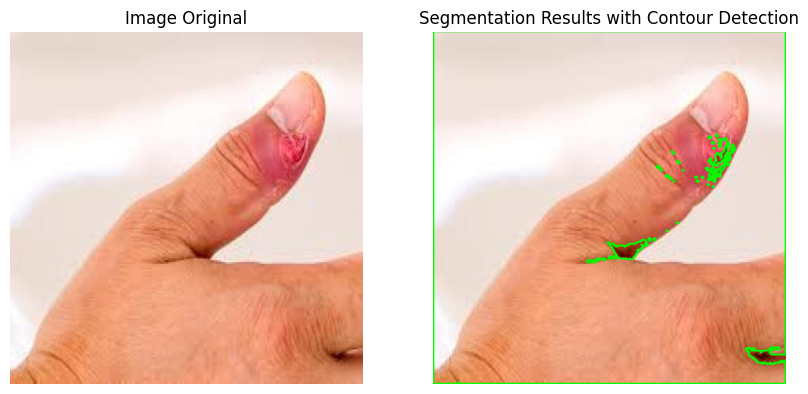

MSE:  3.6859334309895835
PSNR:  21.232664366982


In [72]:
seg_contour_detection(folder='ingrown_nails', number=28, threshold=95)

#### 21. image abrasions(17).jpg

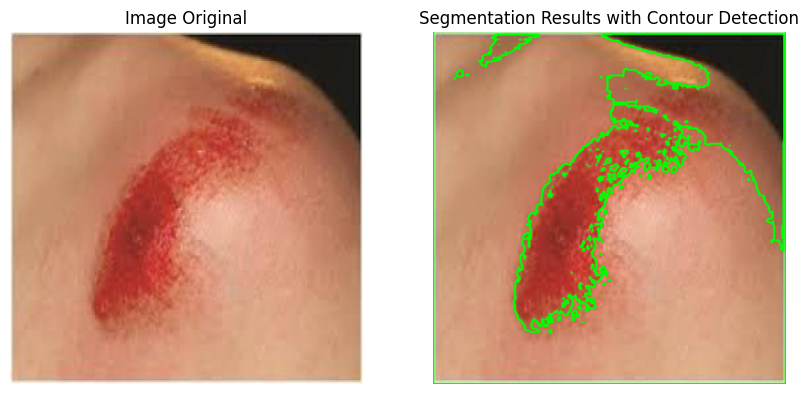

MSE:  8.685899251302084
PSNR:  19.37132786620903


In [73]:
seg_contour_detection(folder='abrasions', number=17, threshold=126)

#### 22. image bruises(18).jpg

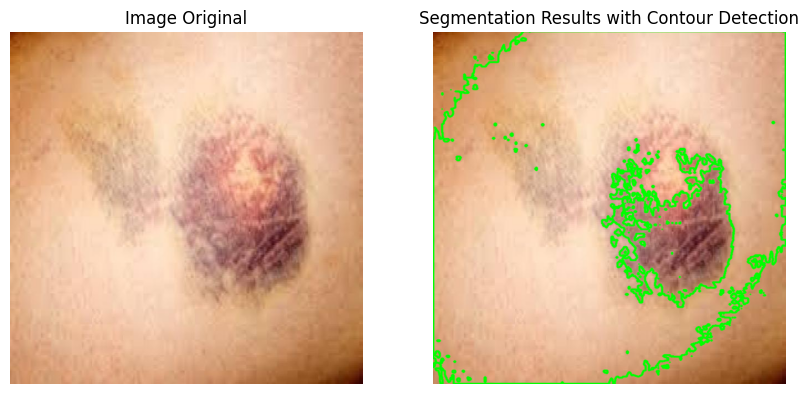

MSE:  9.736570638020833
PSNR:  19.123371709494275


In [74]:
seg_contour_detection(folder='bruises', number=18, threshold=160)

#### 23. image burns(22).jpg

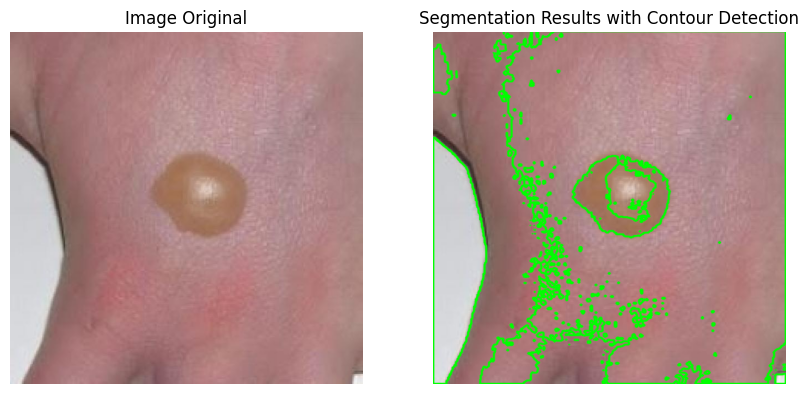

MSE:  10.852112630208333
PSNR:  18.887830341836775


In [75]:
seg_contour_detection(folder='burns', number=22, threshold=131)

#### 24. image cut(9).jpg

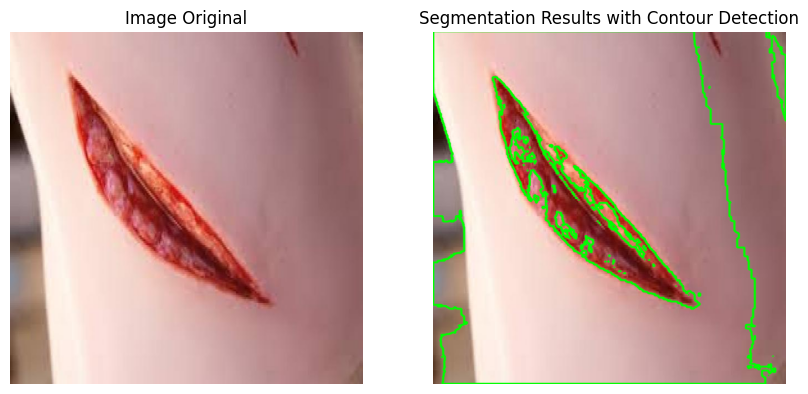

MSE:  8.041802571614584
PSNR:  19.53863477007413


In [76]:
seg_contour_detection(folder='cut', number=20, threshold=125)

#### 25. image laceration(14).jpg

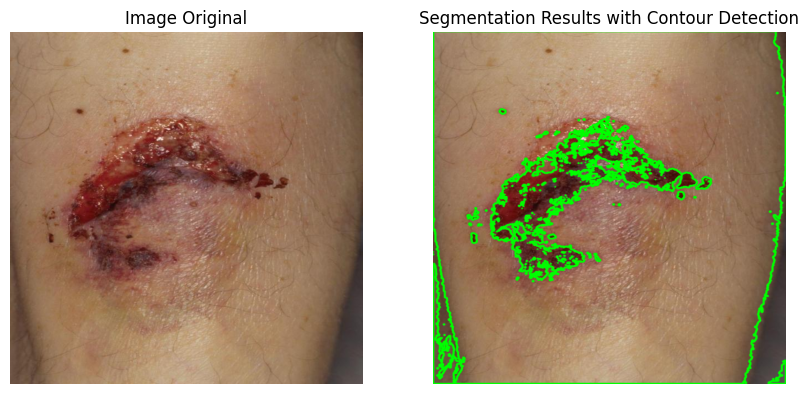

MSE:  10.804869791666667
PSNR:  18.89730411626796


In [77]:
seg_contour_detection(folder='laceration', number=14, threshold=80)

#### 26. image ingrown_nail(16).jpg

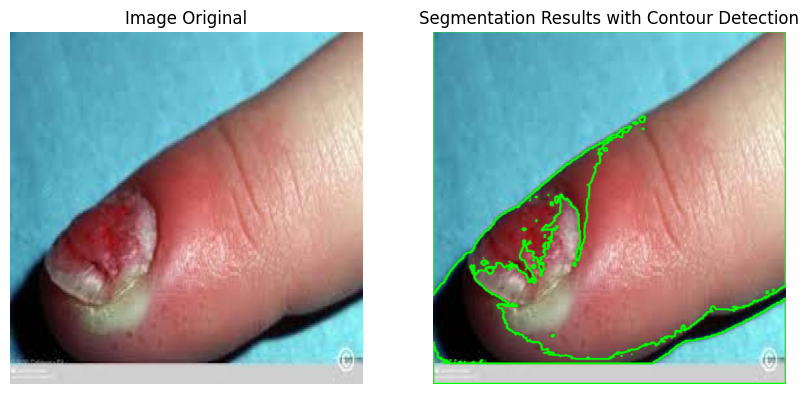

MSE:  6.7164111328125
PSNR:  19.92971544023255


In [78]:
seg_contour_detection(folder='ingrown_nails', number=16, threshold=80)

#### 27. image stab_wound(20).jpg

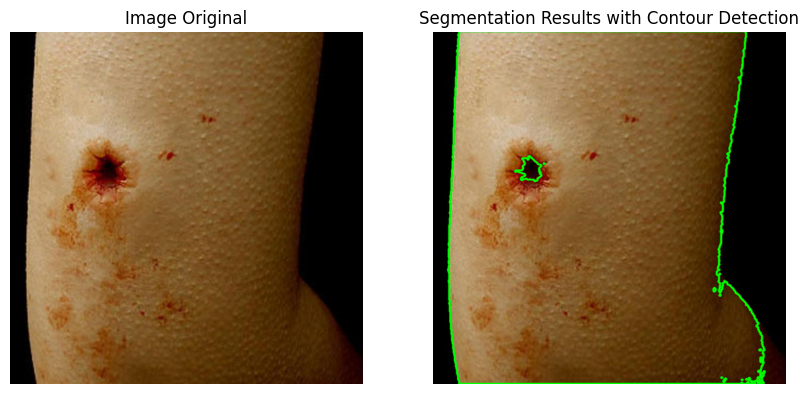

MSE:  2.7130696614583334
PSNR:  21.89809707954456


In [79]:
seg_contour_detection(folder='stab_wound', number=20, threshold=25)

#### 28. image stab_wound(23).jpg

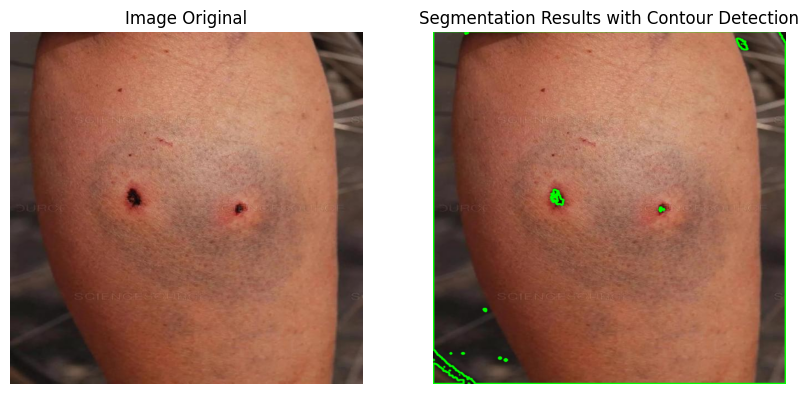

MSE:  2.6555875651041667
PSNR:  21.944598672448432


In [80]:
seg_contour_detection(folder='stab_wound', number=23, threshold=23)

#### 29. image cut().jpg

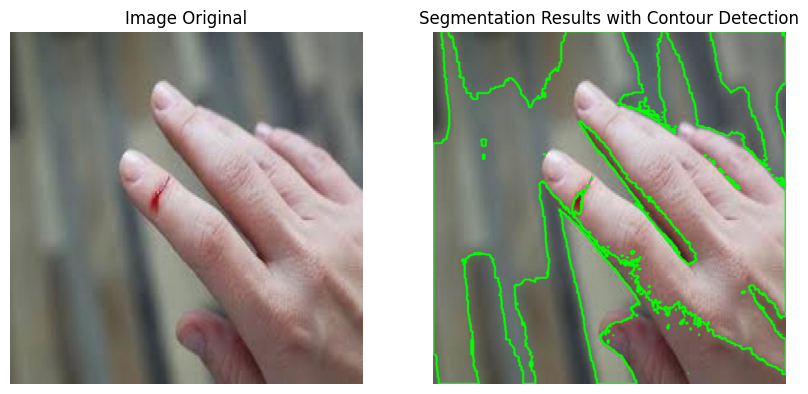

MSE:  10.315066731770834
PSNR:  18.998041594734516


In [81]:
seg_contour_detection(folder='cut', number=11, threshold=103)

#### 30. image laceration(20).jpg 

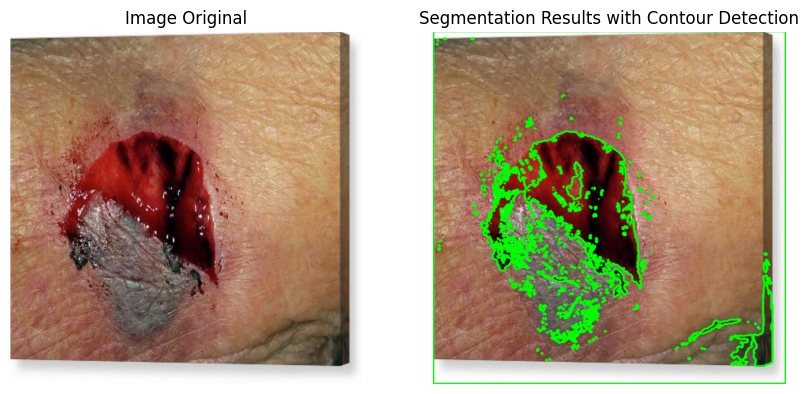

MSE:  11.565751953125
PSNR:  18.74953243485626


In [82]:
seg_contour_detection(folder='laceration', number=20, threshold=68)

### Execution Time Testing

In [83]:
def method_active_contour(folder, number):
    image = cv.imread(pick(folder, number))
    image_grayscale = cv.cvtColor(image, cv.COLOR_BGR2GRAY)
    brightness = 200
    image_brightened = cv.add(image_grayscale, brightness)
    image_denoise = cv.medianBlur(image_brightened, 3)
    image_denoise = cv.fastNlMeansDenoising(image_denoise, None, 10, 10, 7)
    image_contrast_adjusted = cv.equalizeHist(image_denoise)
    s = np.linspace(0, 2*np.pi, 500)
    r = 300 + 300*np.sin(s)
    c = 320 + 300*np.cos(s)
    init = np.array([r, c]).T
    snake = active_contour(gaussian(image_contrast_adjusted, 3, preserve_range=False),
                           init, alpha=0.01, beta=0, gamma=0.001)
    fig, axes = plt.subplots(1, 2, figsize=(10, 5))
    axes[0].set_title("Image Original")
    axes[0].imshow(image[..., ::-1], cmap='gray')
    axes[0].axis('off')
    axes[1].imshow(image[..., ::-1], cmap='gray')
    axes[1].plot(snake[:, 1], snake[:, 0], '-w', lw=3)
    axes[1].set_title("Segmentation Results with Active Contour")
    axes[1].axis('off')
    plt.show()
    difference = np.array(image_denoise) - np.array(image[:, :, 0])
    mse = np.mean(np.square(difference))
    psnr = 10 * np.log10(255 / np.sqrt(mse))
    print("MSE: ", mse)
    print("PSNR: ", psnr)
    
def method_contour_detection(folder, number):
    img = cv.imread(pick(folder, number))
    img_grayscale = cv.cvtColor(img, cv.COLOR_BGR2GRAY)
    ret, thresh = cv.threshold(img_grayscale, 25, 255, cv.THRESH_BINARY)
    contours, hierarchy = cv.findContours(image=thresh, mode=cv.RETR_TREE, method=cv.CHAIN_APPROX_NONE)
    image_copy = img.copy()
    cv.drawContours(image=image_copy, contours=contours, contourIdx=-1, color=(0, 255, 0), thickness=2, lineType=cv.LINE_AA)
    fig, axes = plt.subplots(1, 2, figsize=(10, 5))
    axes[0].imshow(img[..., ::-1], cmap='gray')
    axes[0].set_title("Image Original")
    axes[0].axis('off')
    axes[1].imshow(image_copy[..., ::-1], cmap='gray')
    axes[1].set_title("Segmentation Results with Contour Detection")
    axes[1].axis('off')
    plt.show()
    difference = np.array(image_copy) - np.array(img)
    mse = np.mean(np.square(difference))
    psnr = 10 * np.log10(255 / np.sqrt(mse))
    print("MSE: ", mse)
    print("PSNR: ", psnr)

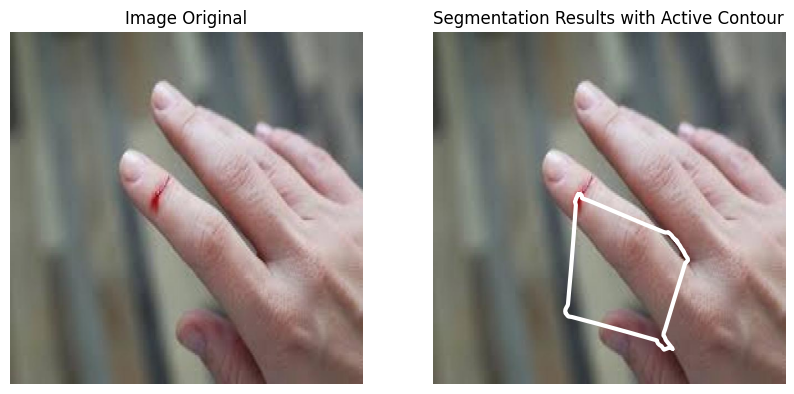

MSE:  109.62063720703125
PSNR:  13.86594019320411


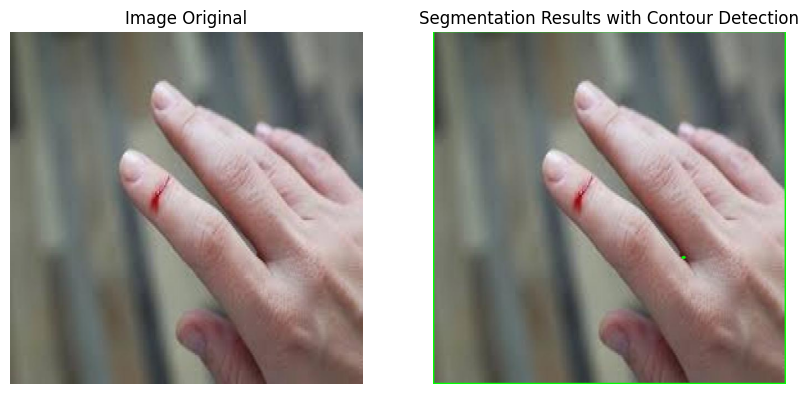

MSE:  2.1678483072916666
PSNR:  22.385257355992664


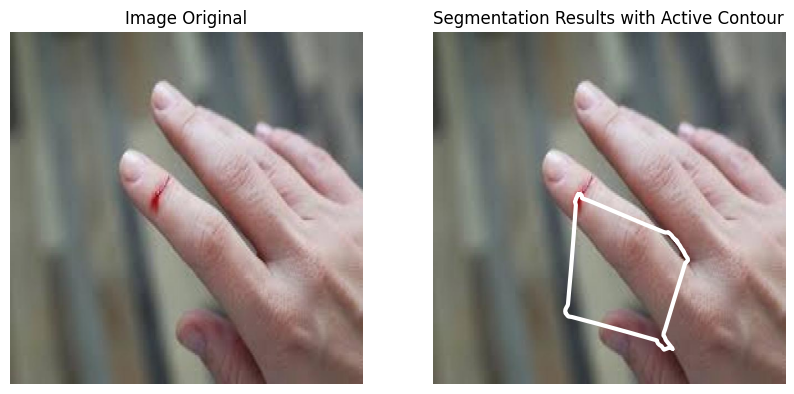

MSE:  109.62063720703125
PSNR:  13.86594019320411


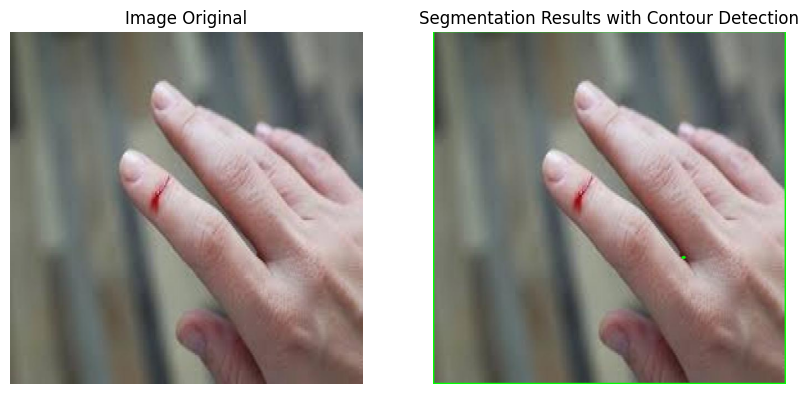

MSE:  2.1678483072916666
PSNR:  22.385257355992664


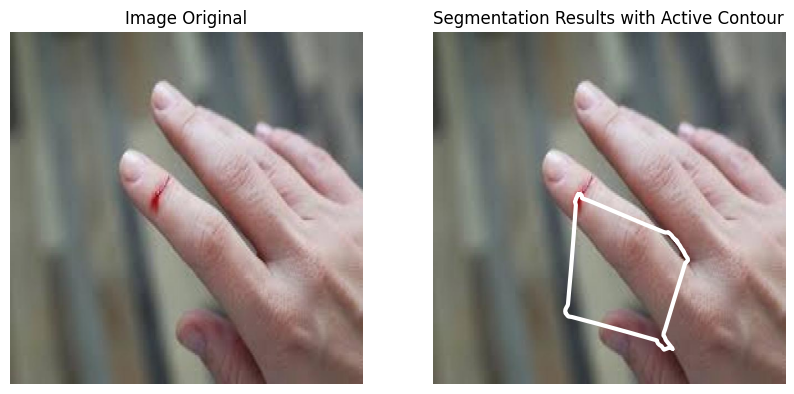

MSE:  109.62063720703125
PSNR:  13.86594019320411


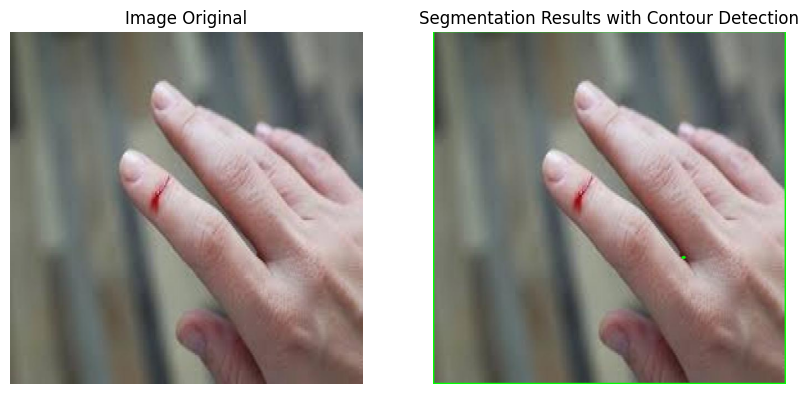

MSE:  2.1678483072916666
PSNR:  22.385257355992664


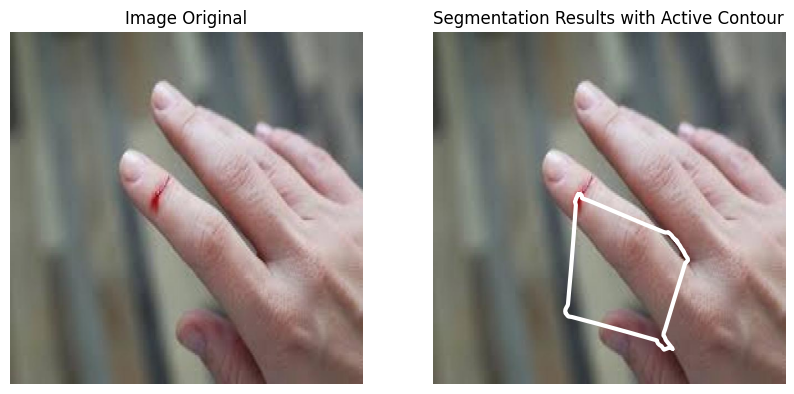

MSE:  109.62063720703125
PSNR:  13.86594019320411


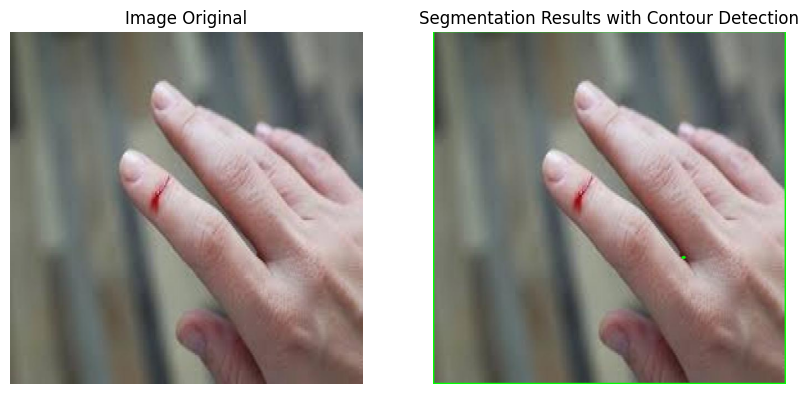

MSE:  2.1678483072916666
PSNR:  22.385257355992664


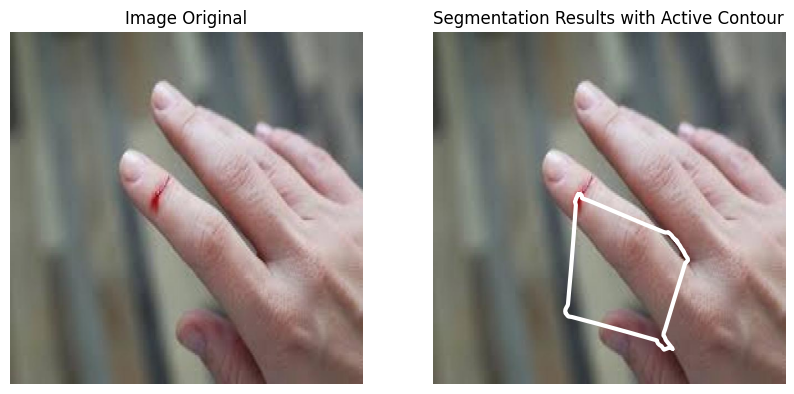

MSE:  109.62063720703125
PSNR:  13.86594019320411


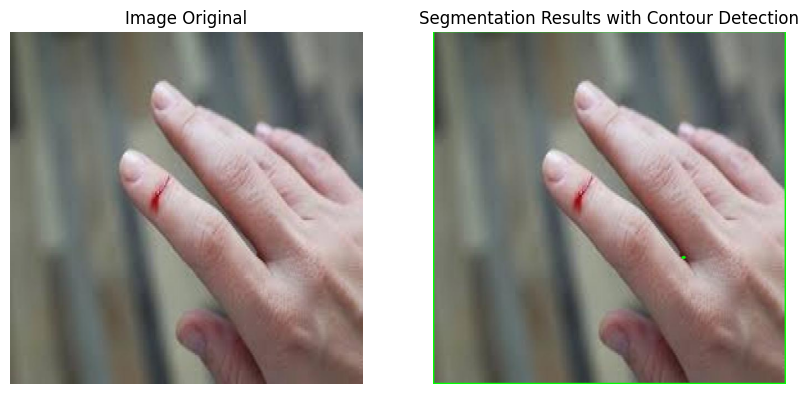

MSE:  2.1678483072916666
PSNR:  22.385257355992664


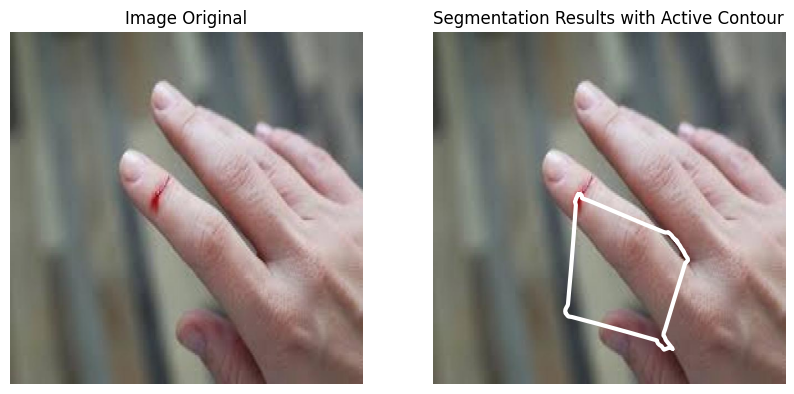

MSE:  109.62063720703125
PSNR:  13.86594019320411


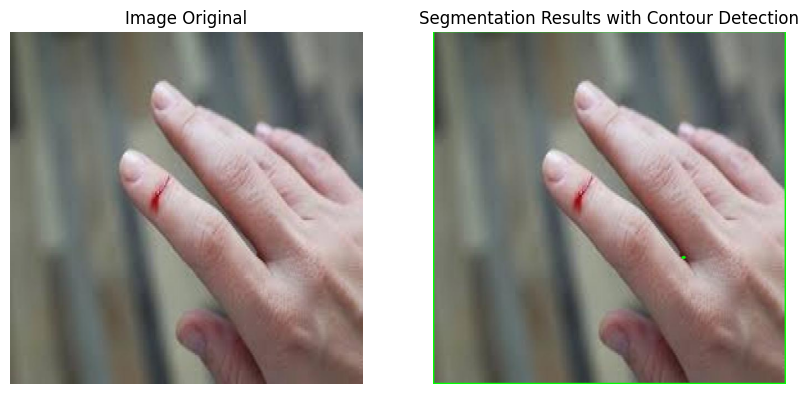

MSE:  2.1678483072916666
PSNR:  22.385257355992664


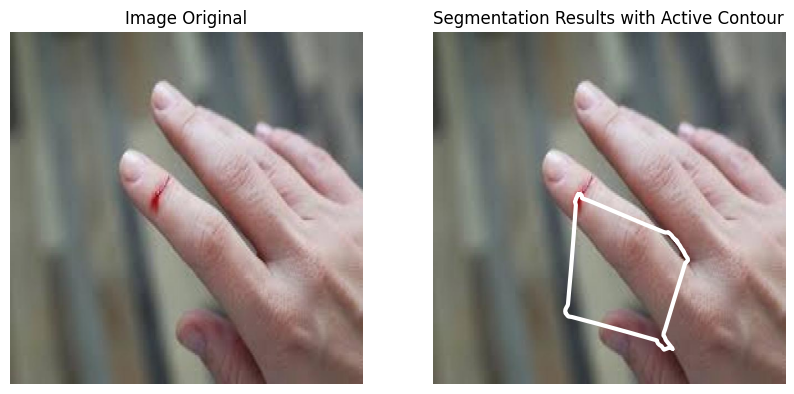

MSE:  109.62063720703125
PSNR:  13.86594019320411


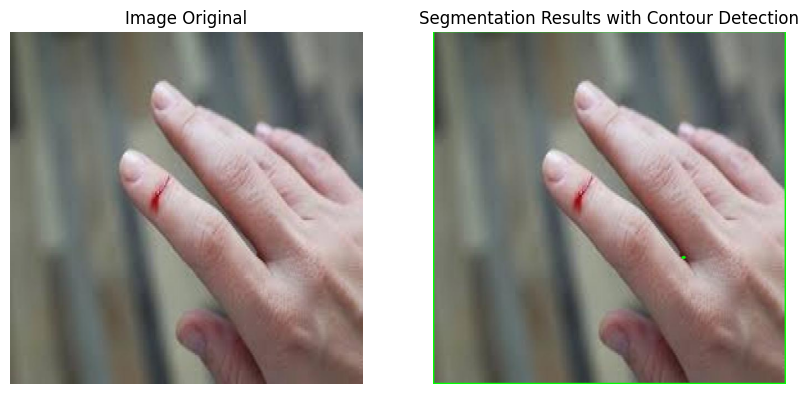

MSE:  2.1678483072916666
PSNR:  22.385257355992664


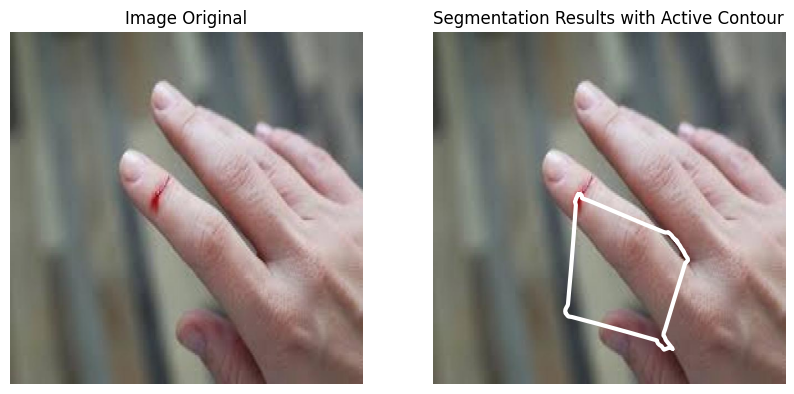

MSE:  109.62063720703125
PSNR:  13.86594019320411


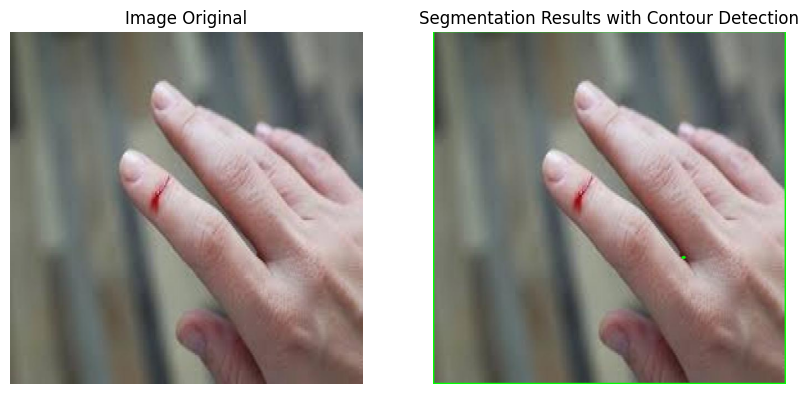

MSE:  2.1678483072916666
PSNR:  22.385257355992664


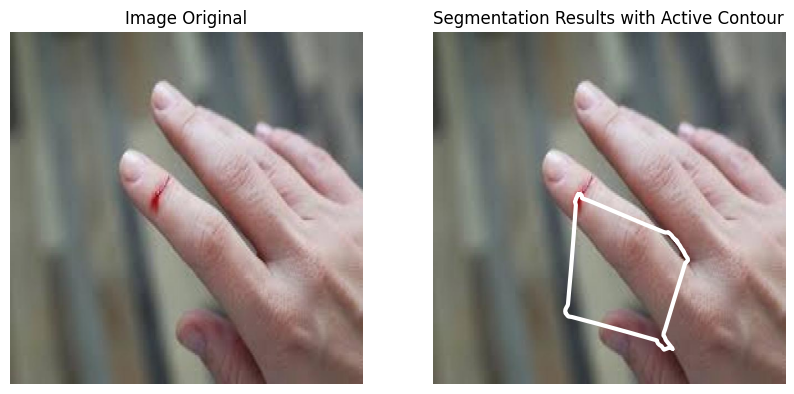

MSE:  109.62063720703125
PSNR:  13.86594019320411


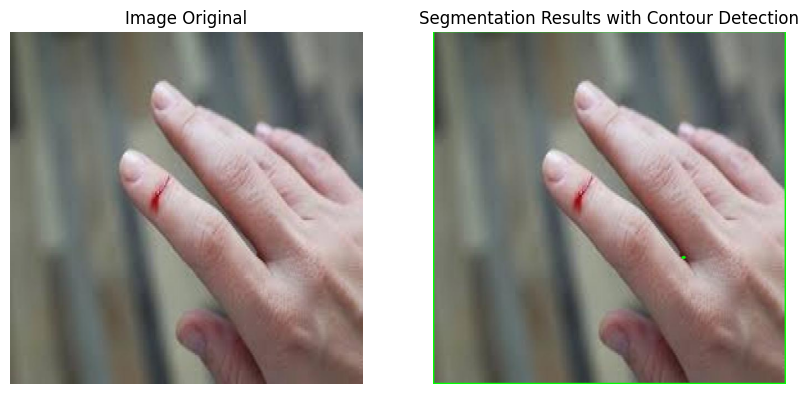

MSE:  2.1678483072916666
PSNR:  22.385257355992664


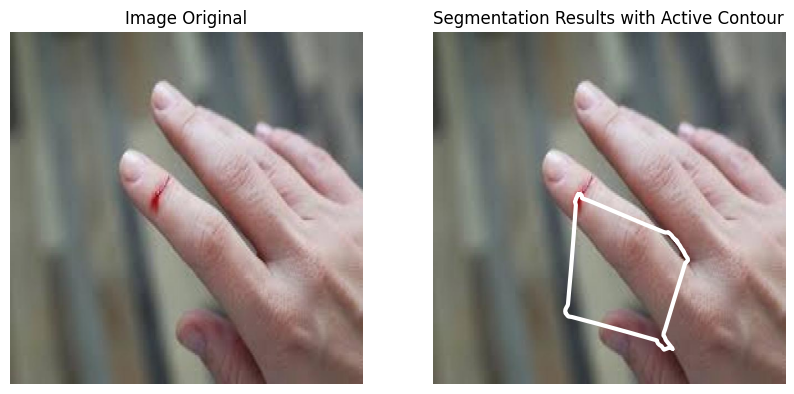

MSE:  109.62063720703125
PSNR:  13.86594019320411


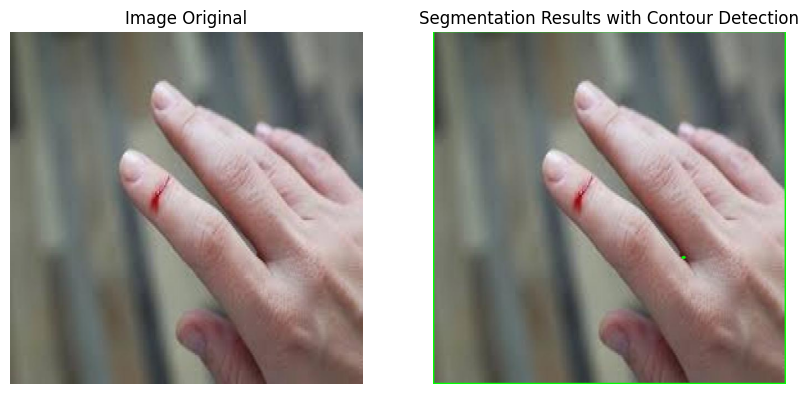

MSE:  2.1678483072916666
PSNR:  22.385257355992664


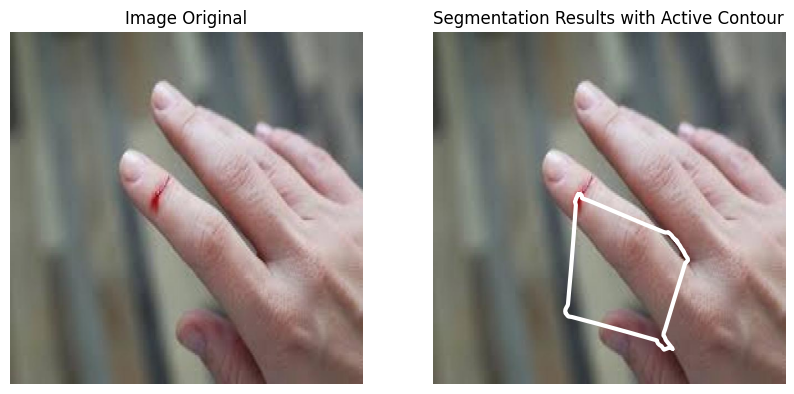

MSE:  109.62063720703125
PSNR:  13.86594019320411


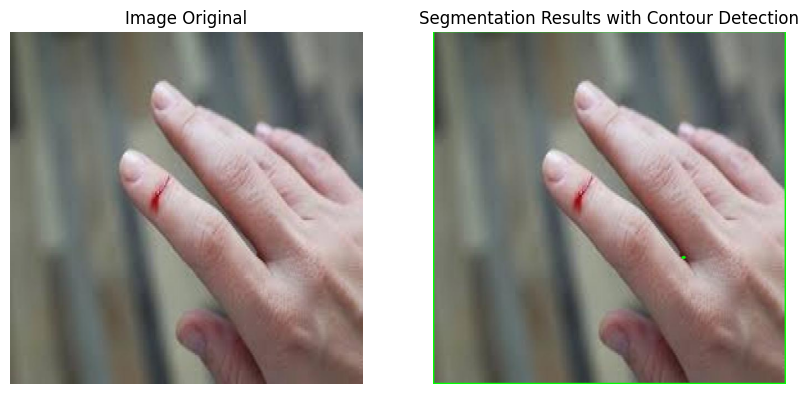

MSE:  2.1678483072916666
PSNR:  22.385257355992664


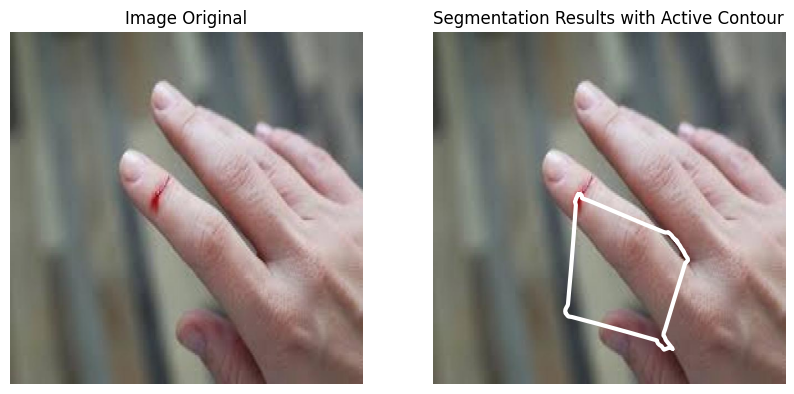

MSE:  109.62063720703125
PSNR:  13.86594019320411


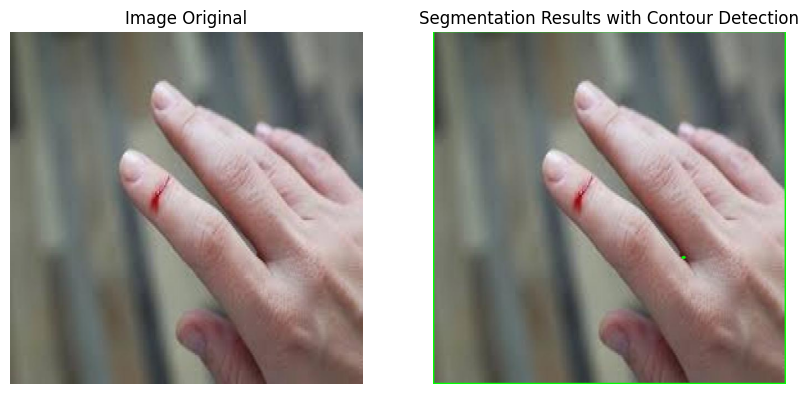

MSE:  2.1678483072916666
PSNR:  22.385257355992664


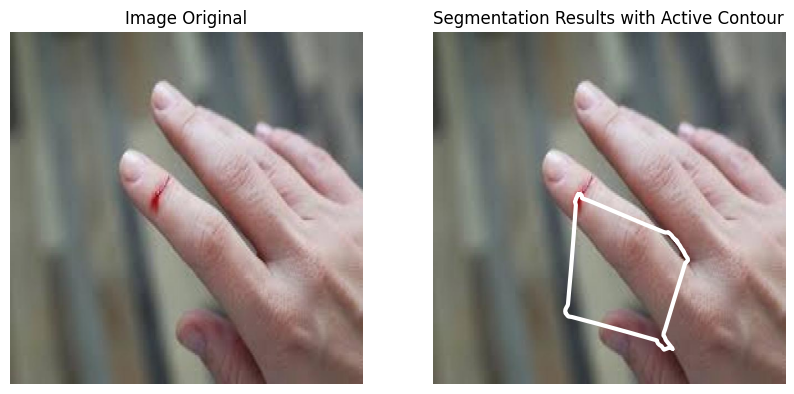

MSE:  109.62063720703125
PSNR:  13.86594019320411


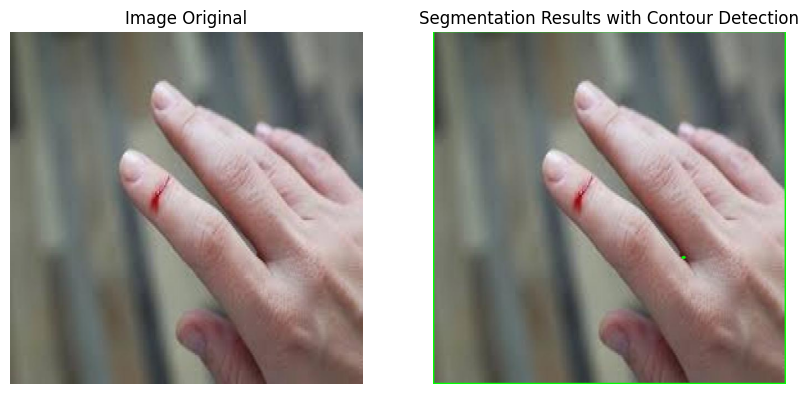

MSE:  2.1678483072916666
PSNR:  22.385257355992664


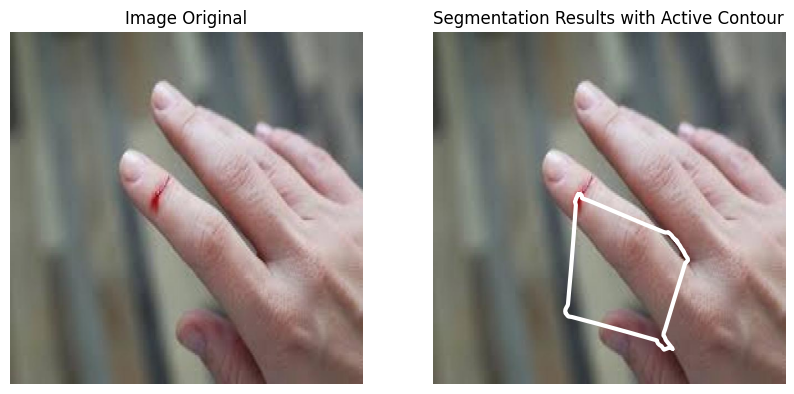

MSE:  109.62063720703125
PSNR:  13.86594019320411


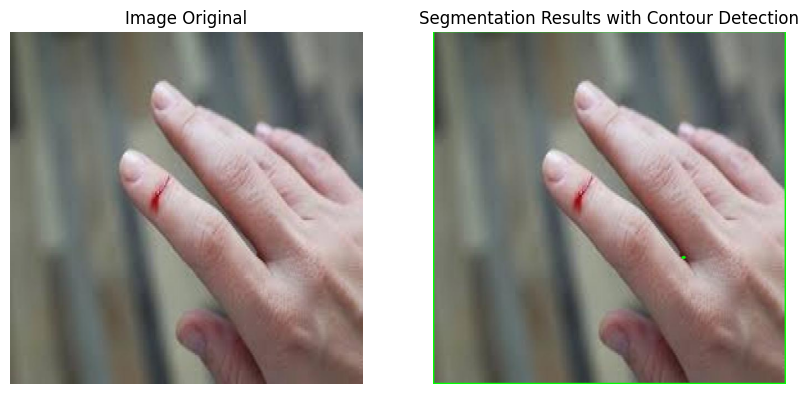

MSE:  2.1678483072916666
PSNR:  22.385257355992664


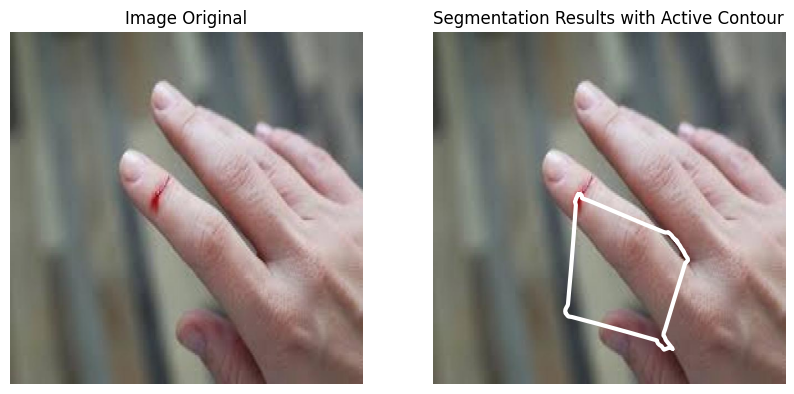

MSE:  109.62063720703125
PSNR:  13.86594019320411


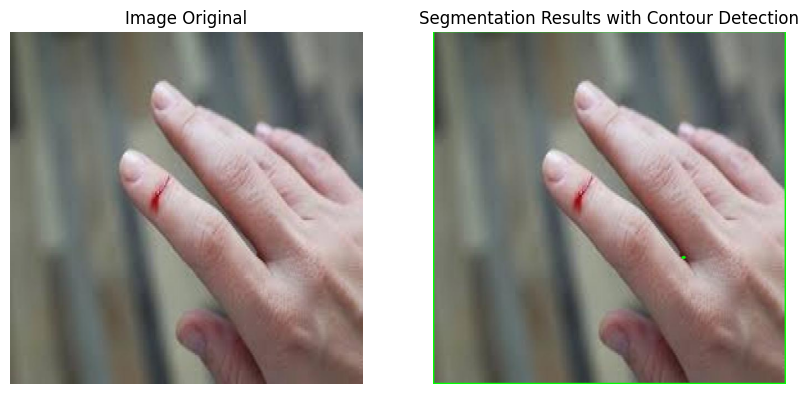

MSE:  2.1678483072916666
PSNR:  22.385257355992664


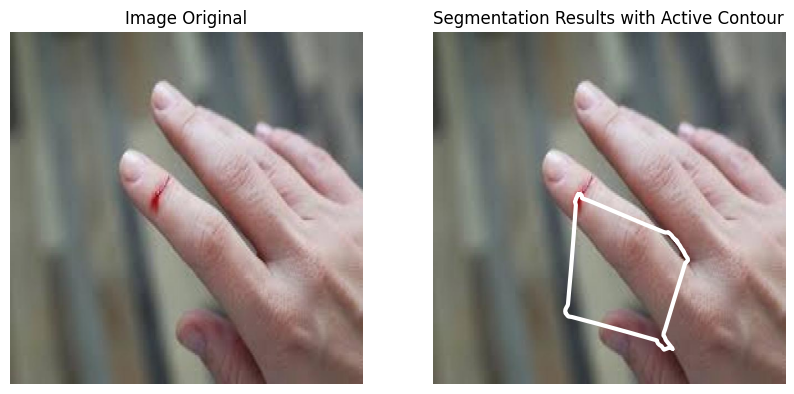

MSE:  109.62063720703125
PSNR:  13.86594019320411


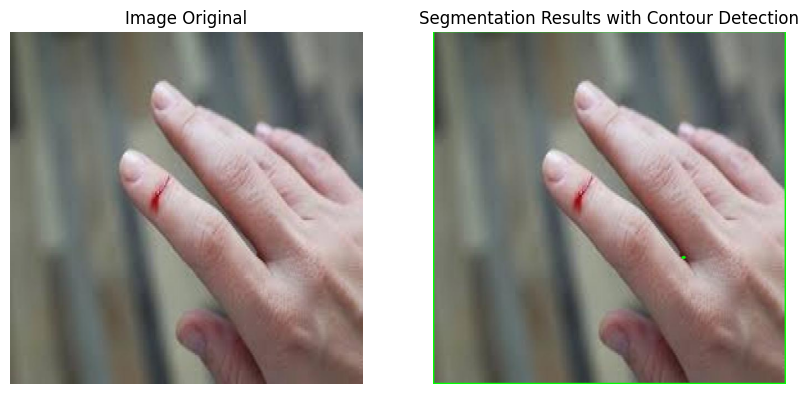

MSE:  2.1678483072916666
PSNR:  22.385257355992664


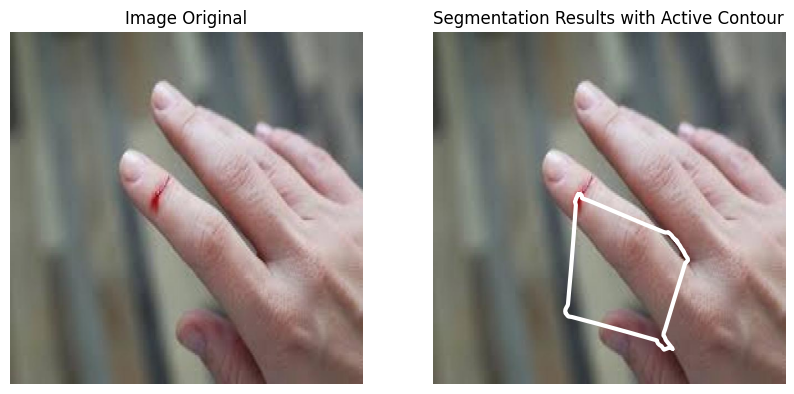

MSE:  109.62063720703125
PSNR:  13.86594019320411


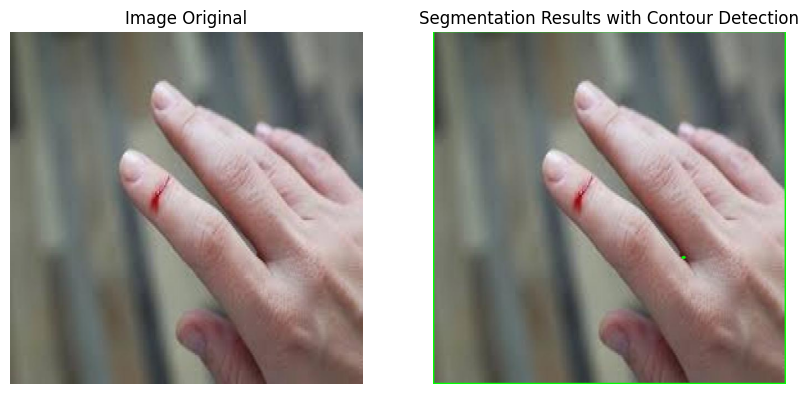

MSE:  2.1678483072916666
PSNR:  22.385257355992664


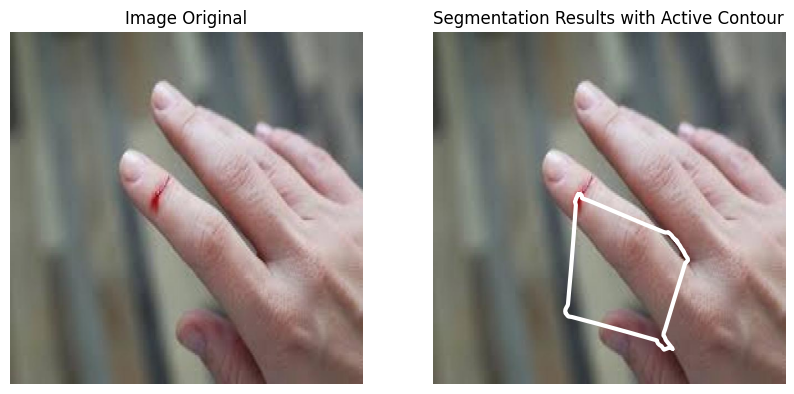

MSE:  109.62063720703125
PSNR:  13.86594019320411


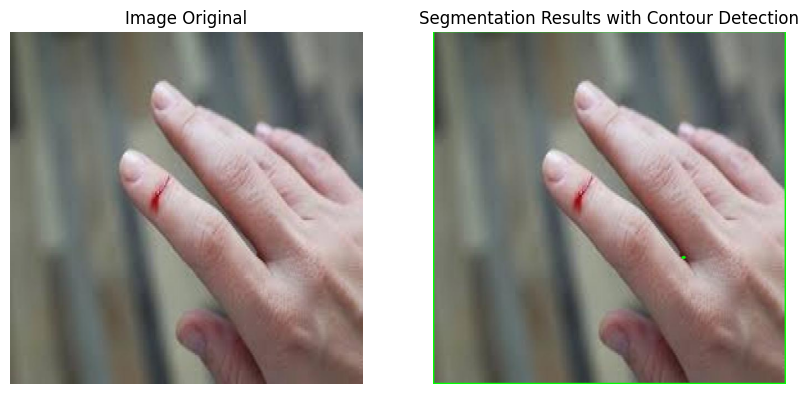

MSE:  2.1678483072916666
PSNR:  22.385257355992664


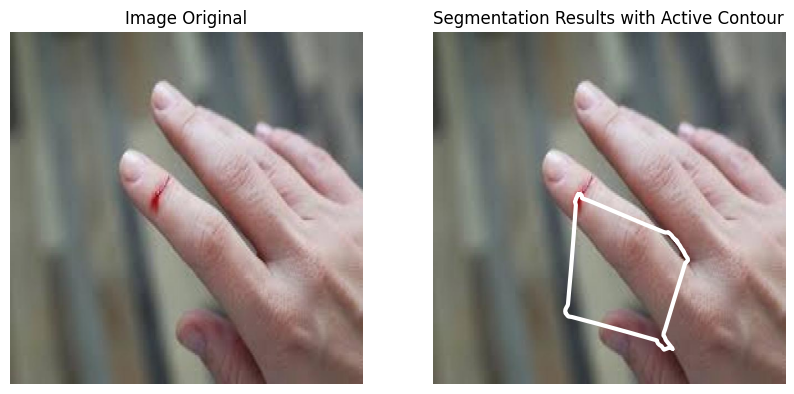

MSE:  109.62063720703125
PSNR:  13.86594019320411


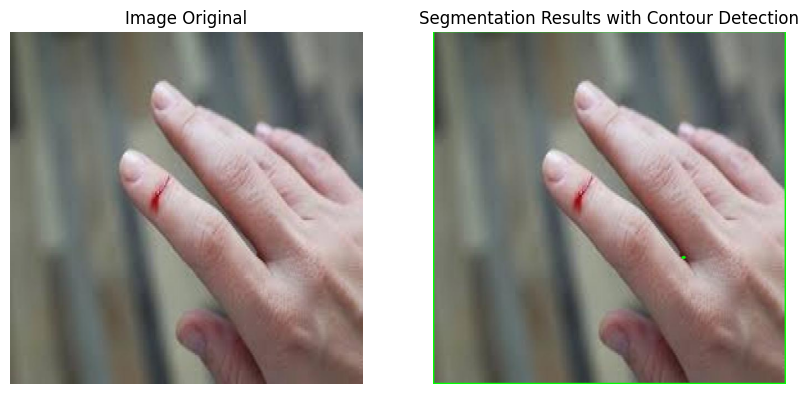

MSE:  2.1678483072916666
PSNR:  22.385257355992664


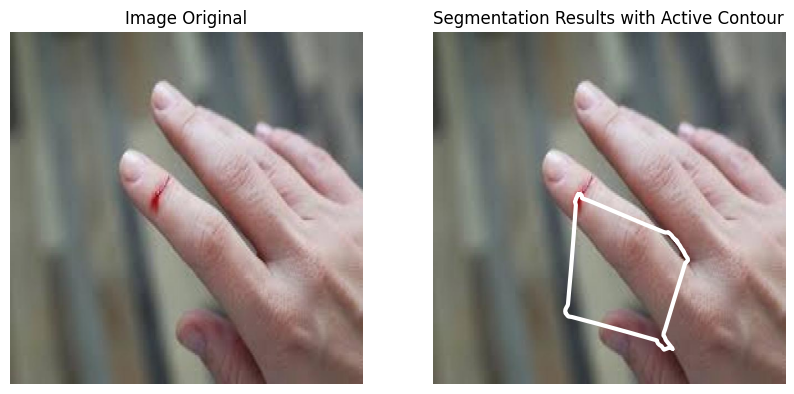

MSE:  109.62063720703125
PSNR:  13.86594019320411


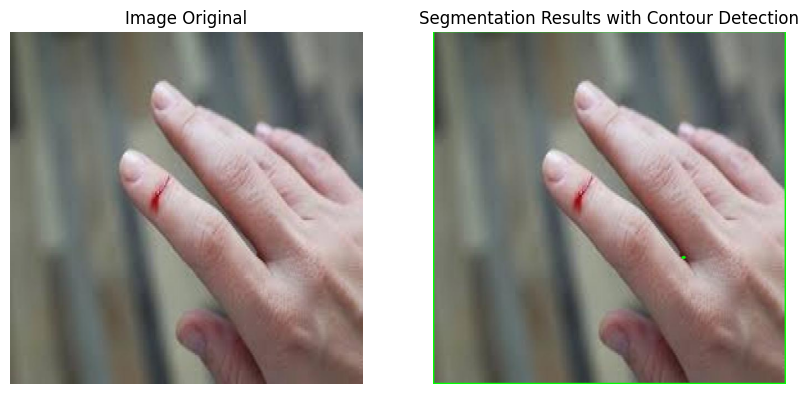

MSE:  2.1678483072916666
PSNR:  22.385257355992664


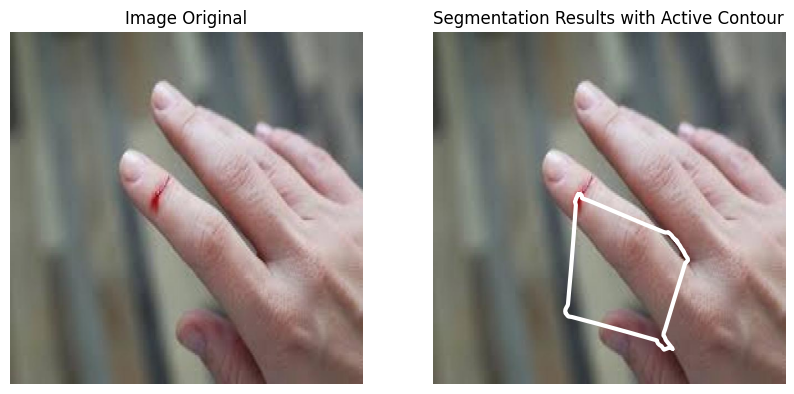

MSE:  109.62063720703125
PSNR:  13.86594019320411


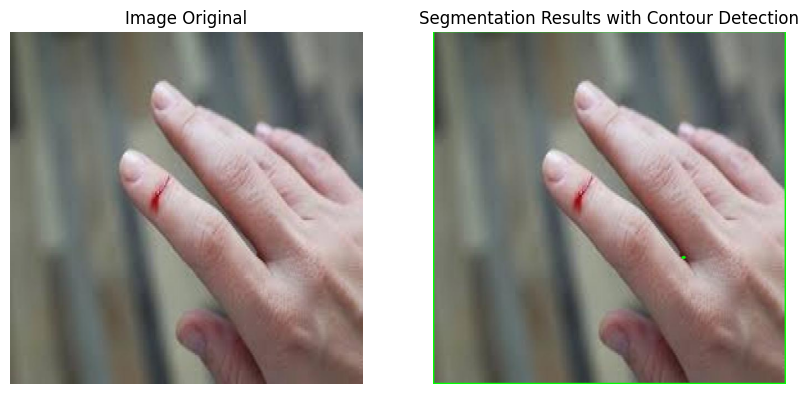

MSE:  2.1678483072916666
PSNR:  22.385257355992664


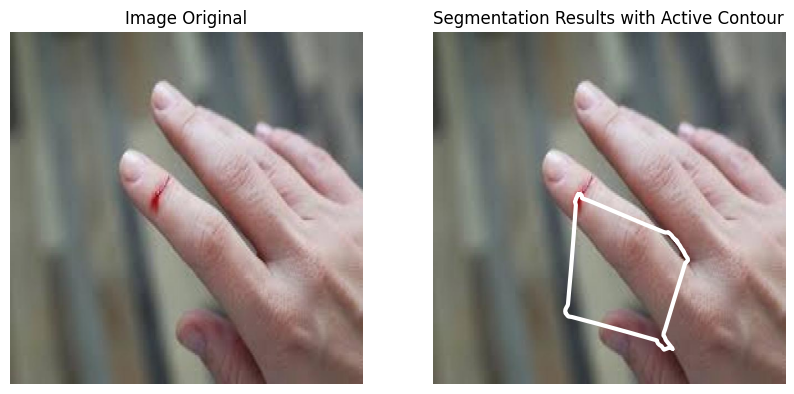

MSE:  109.62063720703125
PSNR:  13.86594019320411


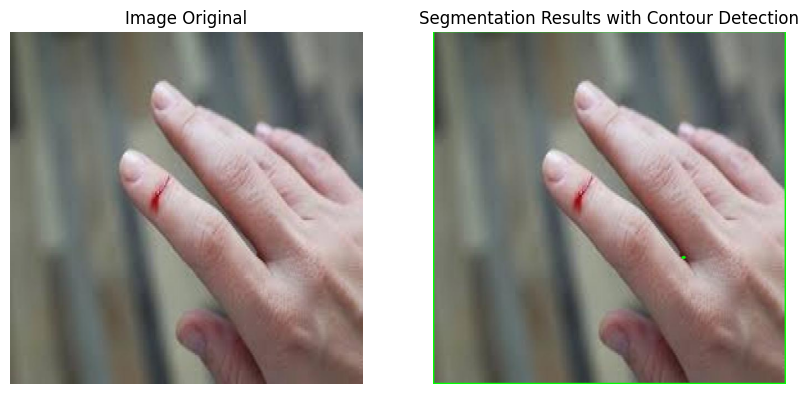

MSE:  2.1678483072916666
PSNR:  22.385257355992664


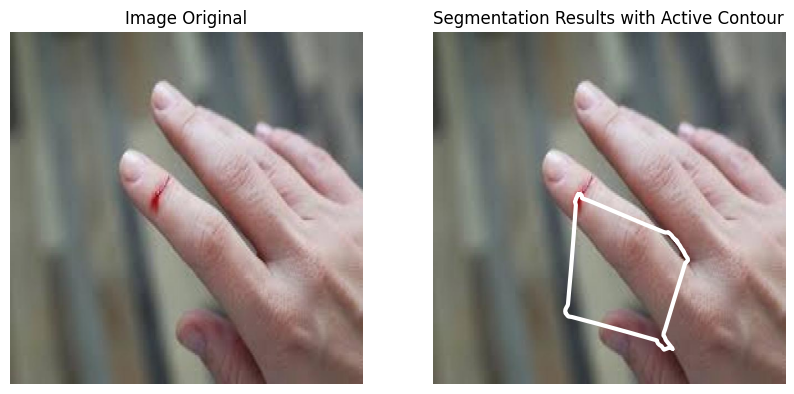

MSE:  109.62063720703125
PSNR:  13.86594019320411


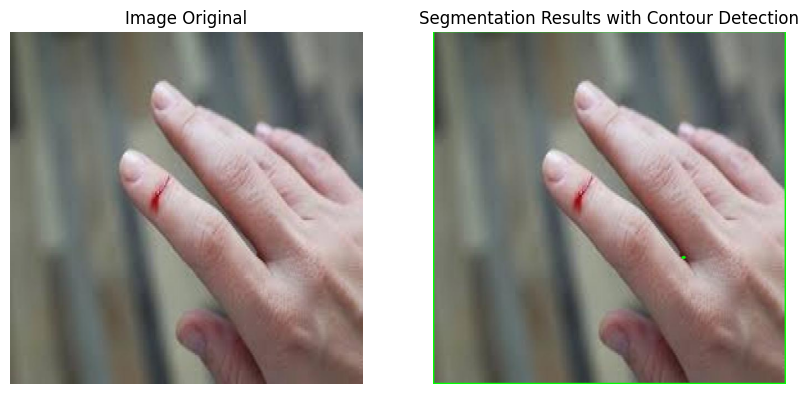

MSE:  2.1678483072916666
PSNR:  22.385257355992664


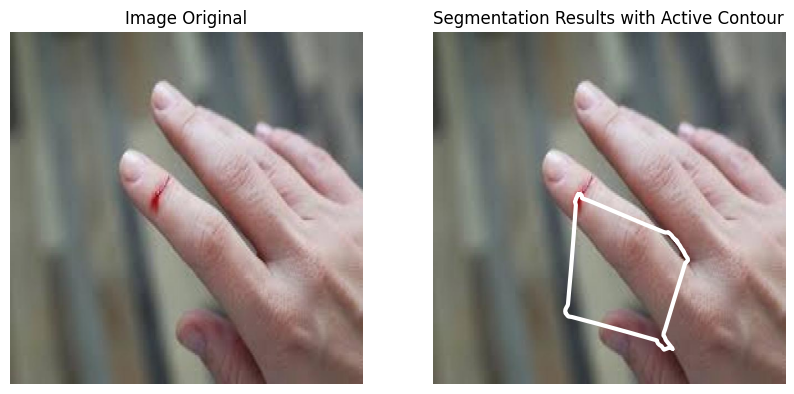

MSE:  109.62063720703125
PSNR:  13.86594019320411


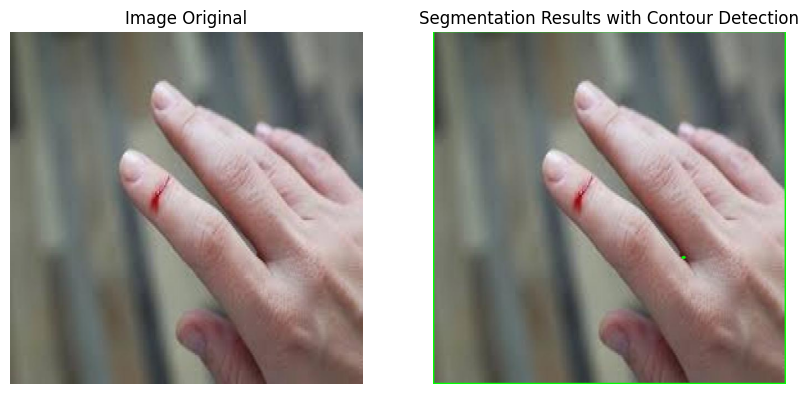

MSE:  2.1678483072916666
PSNR:  22.385257355992664


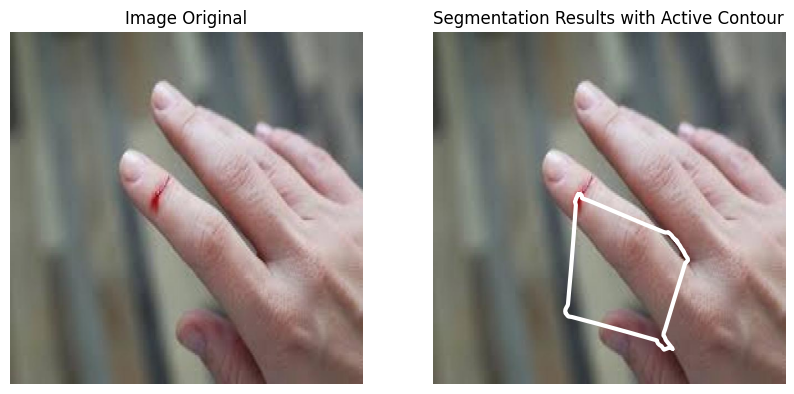

MSE:  109.62063720703125
PSNR:  13.86594019320411


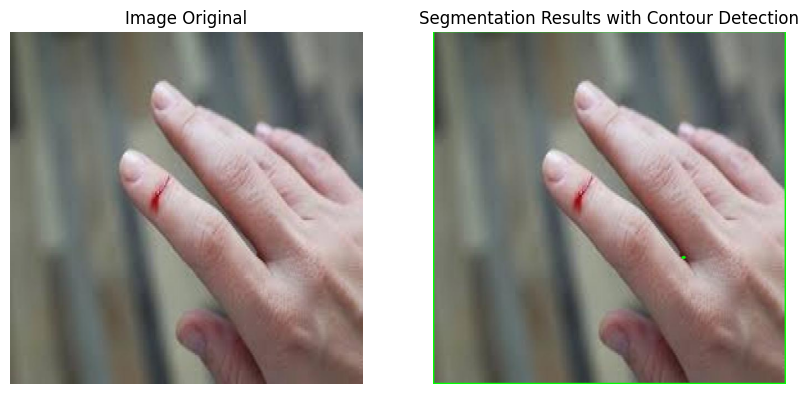

MSE:  2.1678483072916666
PSNR:  22.385257355992664


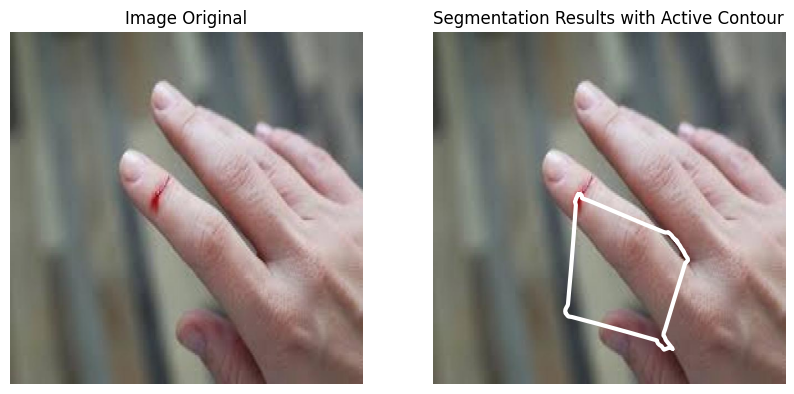

MSE:  109.62063720703125
PSNR:  13.86594019320411


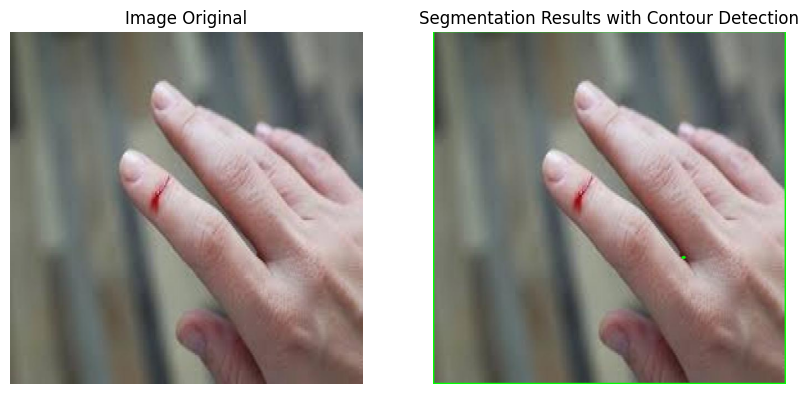

MSE:  2.1678483072916666
PSNR:  22.385257355992664


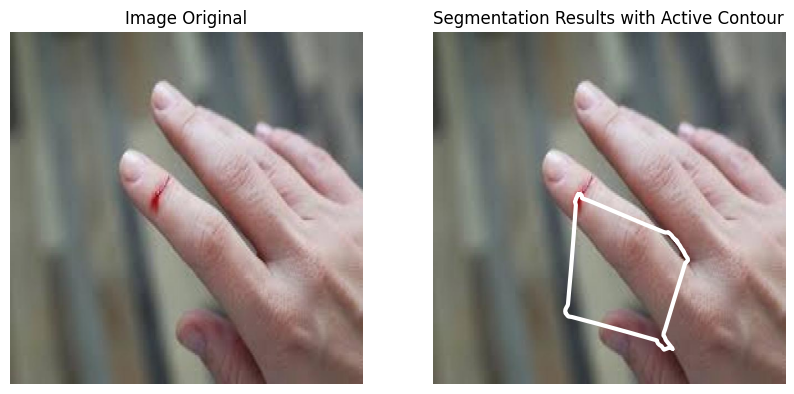

MSE:  109.62063720703125
PSNR:  13.86594019320411


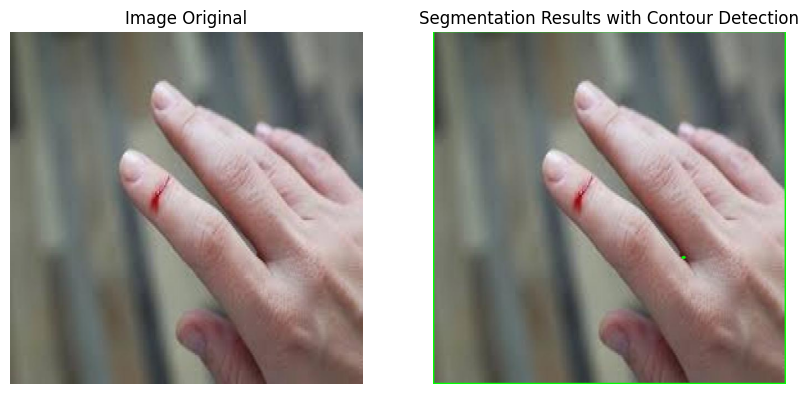

MSE:  2.1678483072916666
PSNR:  22.385257355992664


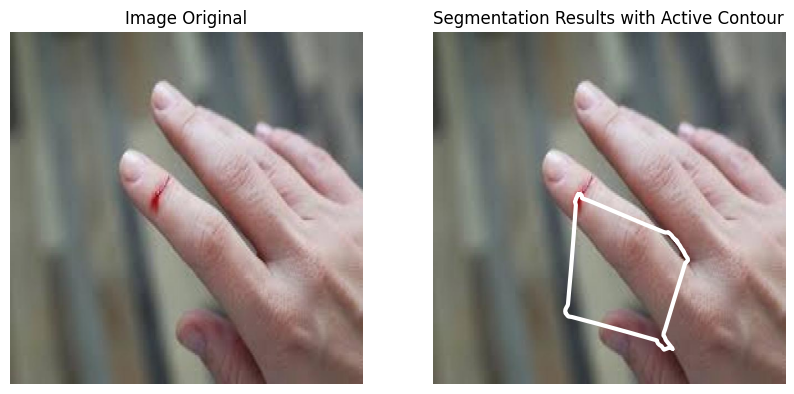

MSE:  109.62063720703125
PSNR:  13.86594019320411


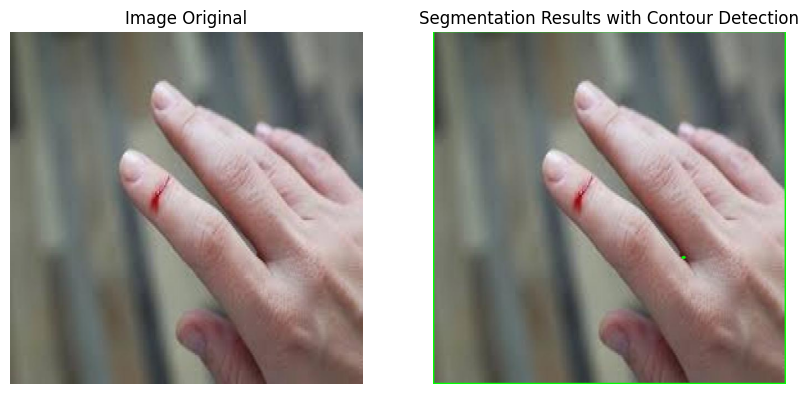

MSE:  2.1678483072916666
PSNR:  22.385257355992664


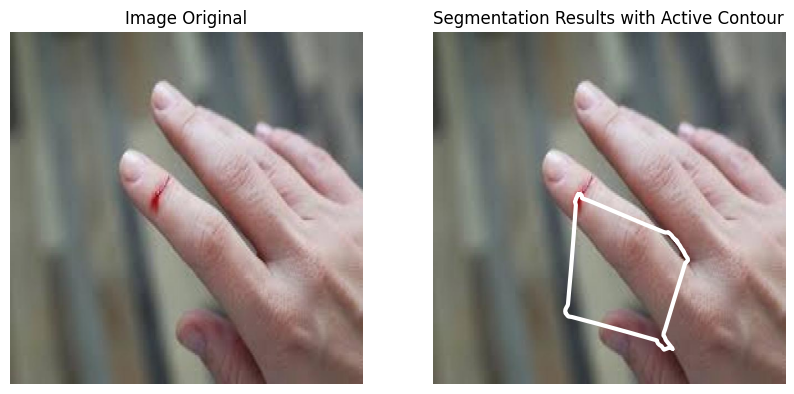

MSE:  109.62063720703125
PSNR:  13.86594019320411


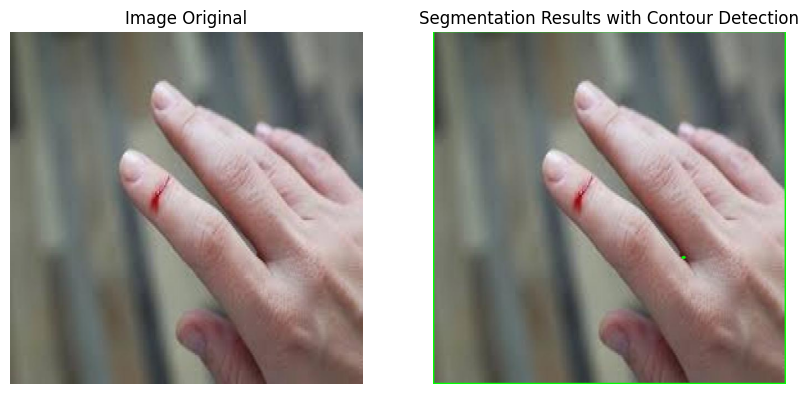

MSE:  2.1678483072916666
PSNR:  22.385257355992664


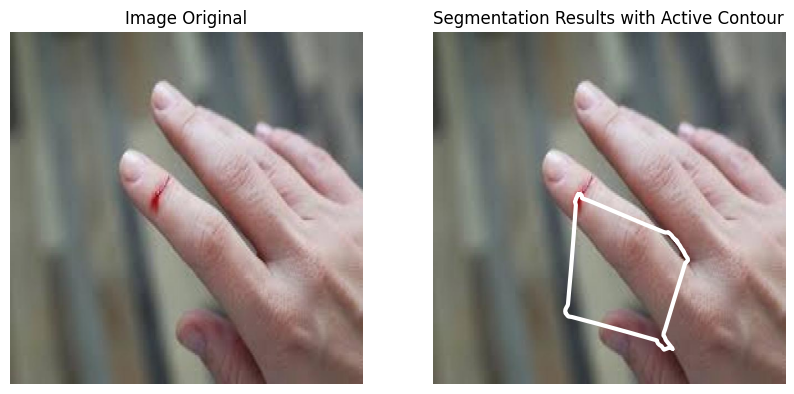

MSE:  109.62063720703125
PSNR:  13.86594019320411


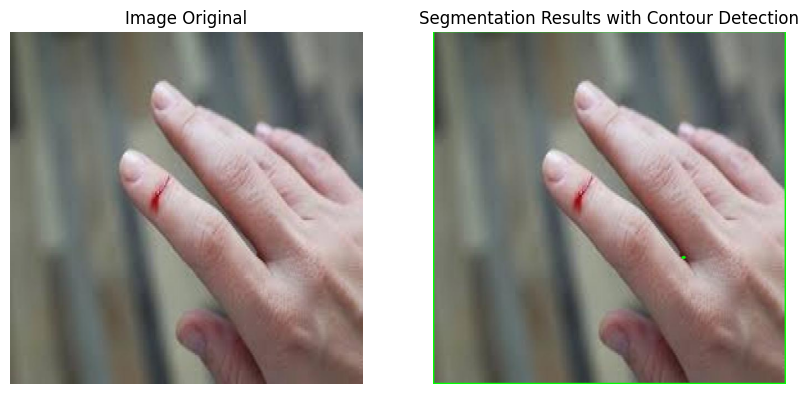

MSE:  2.1678483072916666
PSNR:  22.385257355992664
Average Active Contour Execution Time: 12.182715328534444 second
Average Contour Detection Execution Time: 0.25203890800476075 second


,Active Contour,Contour Detection
0,11.999927,0.236403
1,12.186522,0.259693
2,12.196125,0.267714
3,12.169344,0.229934
4,12.004296,0.246234
5,11.961853,0.236258
6,12.291687,0.364140
7,12.435025,0.233174
8,12.090657,0.237282
9,12.073244,0.239035


In [84]:
# Image folder and number
folder = 'cut'
number = 11

# Initialize a list to store execution results and accuracy
execution_times_active_contour = []
execution_times_contour_detection = []

# Perform iterations 30 times
for _ in range(30):
    start_time = time.time()
    method_active_contour(folder, number)
    execution_time = time.time() - start_time
    execution_times_active_contour.append(execution_time)

    start_time = time.time()
    method_contour_detection(folder, number)
    execution_time = time.time() - start_time
    execution_times_contour_detection.append(execution_time)

# Calculates the execution average
avg_execution_time_active_contour = np.mean(execution_times_active_contour)
avg_execution_time_contour_detection = np.mean(execution_times_contour_detection)

# Displays a comparison of execution averages
print("Average Active Contour Execution Time:", avg_execution_time_active_contour, "second")
print("Average Contour Detection Execution Time:", avg_execution_time_contour_detection, "second")

# Combining the execution_times_active_contour and execution_times_contour_detection lists into a 2D array
data = np.array([execution_times_active_contour, execution_times_contour_detection]).T

# Creates a DataFrame from an array and displays a table
pd.DataFrame(data, columns=['Active Contour', 'Contour Detection'])